# Advanced Lane Finding #

In [1]:
#Basic Imports
import numpy as np
import glob
import cv2
#import math

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#from mpl_toolkits.axes_grid1 import ImageGrid

import os

from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline
FIGSIZE = (16, 8)

In [2]:
#Initializing some required variables
#lists to store the processed images which then I ultimately used to prepare combined grid of images

imgpoints = [] # 2D points in image plane
objpoints = [] # 3D points in real world space

objp = np.zeros((6*9,3),np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2) # x, y coordinate

corner_images = []

undistorted_images = []

## Advanced Lane Finding Steps ##

* Camera Callibration
* Distortion Correction
* Color & Gradient threshhold
* Perspective transform
* Locate the Lane Lines and Fit a Polynomial
* Sliding window search
* Measuring Curvature


### Camera Callibration

In [3]:
#Used to draw Chessboard Corners on the chess board images. Also, imgpoints and objpoints are added to list.
def find_corners(img, nx=9, ny=6):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        corner_images.append(img)
        
        #Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        plt.figure(figsize=(8,5))
        plt.imshow(img)
        plt.show()
    else:
        corner_images.append(img)
        


### Distortion Correction

In [4]:
#Based on the imgpoints and objpoints found in previous function draw_corners, the Camera Matrix, distortion 
#coefficients, Radial distortion vector and tangential distortion vector are calculated. And then using this 
#camera matrix and distortion coefficient, the input image is undistorted
def undistort_img(img):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[0:2], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=30)

    return undist

### Color & Gradient threshhold

In [5]:
def absolute_threshold(img, thresh=(0,255)):
    # 1) Create a mask of 1's where image is > thresh_min and < thresh_max
    binary = np.zeros_like(img)
    binary[(img > thresh[0]) & (img <= thresh[1])] = 1
    # 2) Return this mask as your binary_output image
    return binary

#Applies color threshold to R channel and S channel images and then combines the pixels of this images.
def color_threshold(img):
    r_channel = img[:,:,2]
    r_thresh = absolute_threshold(r_channel, thresh=(200,255))
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_thresh = absolute_threshold(s_channel, thresh=(90,255))
    color_combined = np.zeros_like(s_thresh)
    color_combined[((r_thresh==1)|(s_thresh==1))] = 1
    return color_combined



def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # 1) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1)
        
    # 2) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 3) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 4) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sbinary = np.zeros_like(scaled_sobel)
    sbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # 5) Return this mask as your binary_output image
    return sbinary

#Applies the Gradient magnitude threshold with kernal size of 9 and threshold values of 30 and 100
def magnitude_threshold(img, sobel_kernel=9, mag_thresh=(30, 100)):
    
    # 1) Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 2) Calculate the magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255 
    
    # 3) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    
    # 4) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return binary_output


#Applies the Gradient Direction threshold with kernal size of 15 and threshold values of 0.7 and 1.3 as given in the sample code
def direction_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3)):
    
    # 1) Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 2) Take the absolute value of the x and y gradients
    # 3) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    
    # 4) Create a binary mask where direction thresholds are met
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    
    # 5) Return this mask as your binary_output image  
    return binary_output

# Apply each of the thresholding functions
def applythresholds(img):
    gradx = abs_sobel_thresh(img, orient='x', thresh_min=20, thresh_max=100)
    grady = abs_sobel_thresh(img, orient='y', thresh_min=20, thresh_max=100)
    mag_binary = magnitude_threshold(img)
    dir_binary = direction_threshold(img)

    grad_combined = np.zeros_like(dir_binary)
    grad_combined[((gradx==1)|(mag_binary == 1)) & ((grady == 1)|(mag_binary == 1))] = 1
    
    return grad_combined

def combinethresh(grad_thresh, color_thresh):
    combined_color_grad = np.zeros_like(grad_thresh)
    combined_color_grad[(grad_thresh==1) & (color_thresh==1)] = 1
    return combined_color_grad

### Perspective transform

In [6]:
def drawQuad(image, points, color=[255, 0, 0], thickness=4):
    p1, p2, p3, p4 = points
    cv2.line(image, tuple(p1), tuple(p2), color, thickness)
    cv2.line(image, tuple(p2), tuple(p3), color, thickness)
    cv2.line(image, tuple(p3), tuple(p4), color, thickness)
    cv2.line(image, tuple(p4), tuple(p1), color, thickness)

In [7]:
#image warping step
def perspective_transform(img):
    img_size = (img.shape[1], img.shape[0])

    #top right, bottom right, bottom left, top left
    src = np.float32([[490, 482],[810, 482], [1250, 720],[40, 720]])
    dst = np.float32([[0, 0], [1280, 0], [1250, 720],[40, 720]])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped_img = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    #if debug:
    #drawQuad(img, src, [255, 0, 0])
    #drawQuad(img, dst, [255, 255, 0])
    #plt.imshow(img)
    #plt.show()
    
    return warped_img, M, Minv

### Testing Camera Caliberation ###

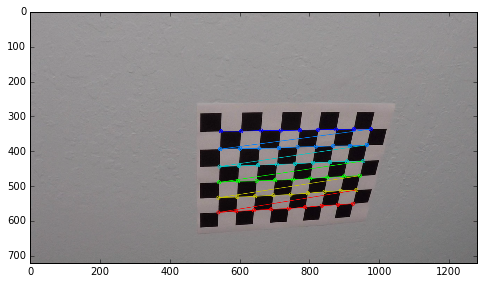

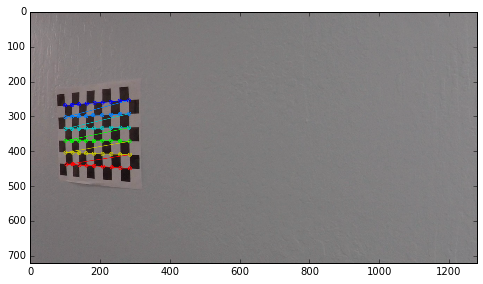

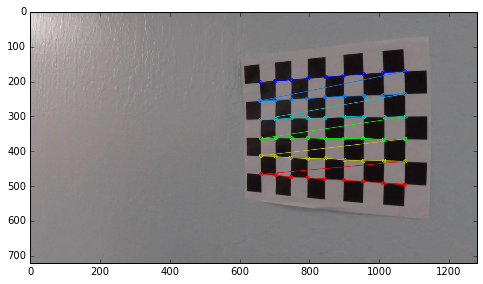

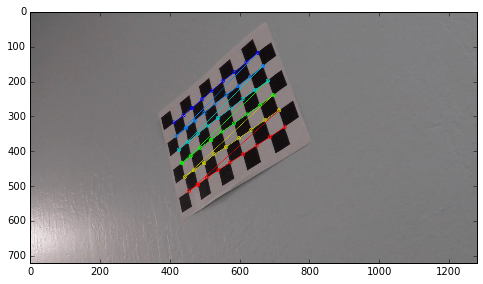

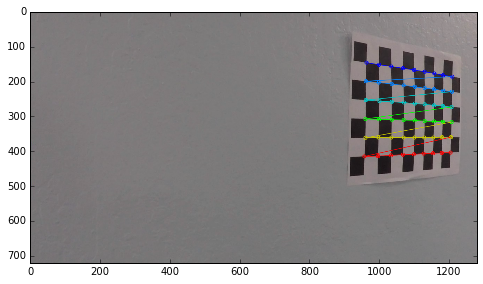

...

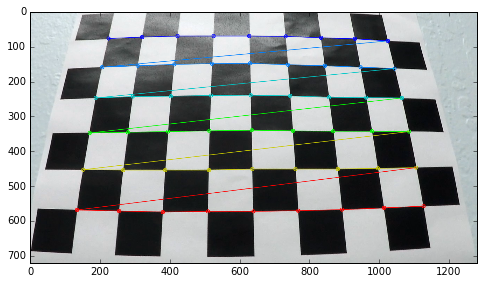

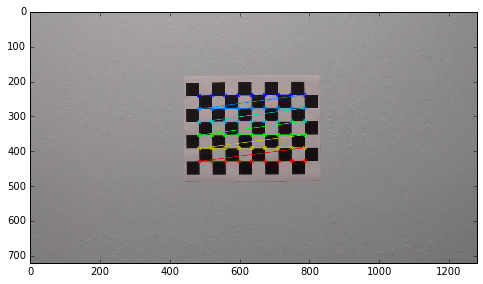

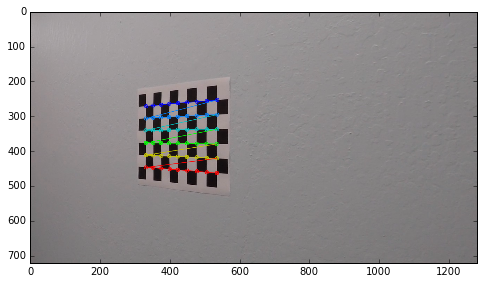

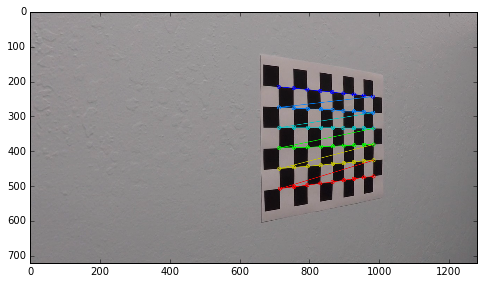

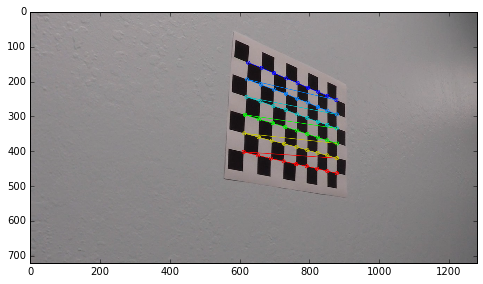

In [8]:
#To Calibrate Camera
# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    find_corners(img)

## Applying thresholds on a test image ##

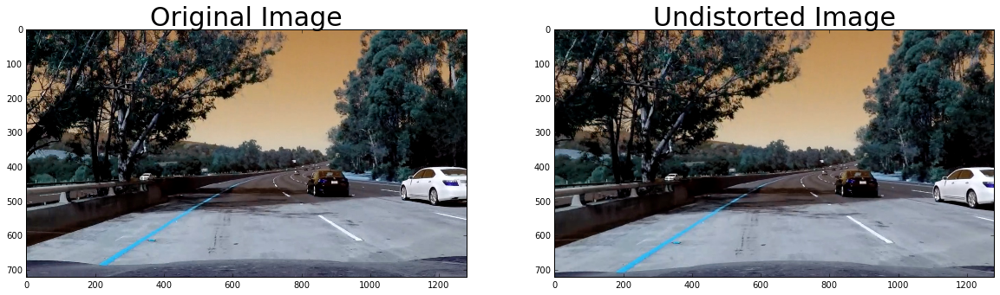

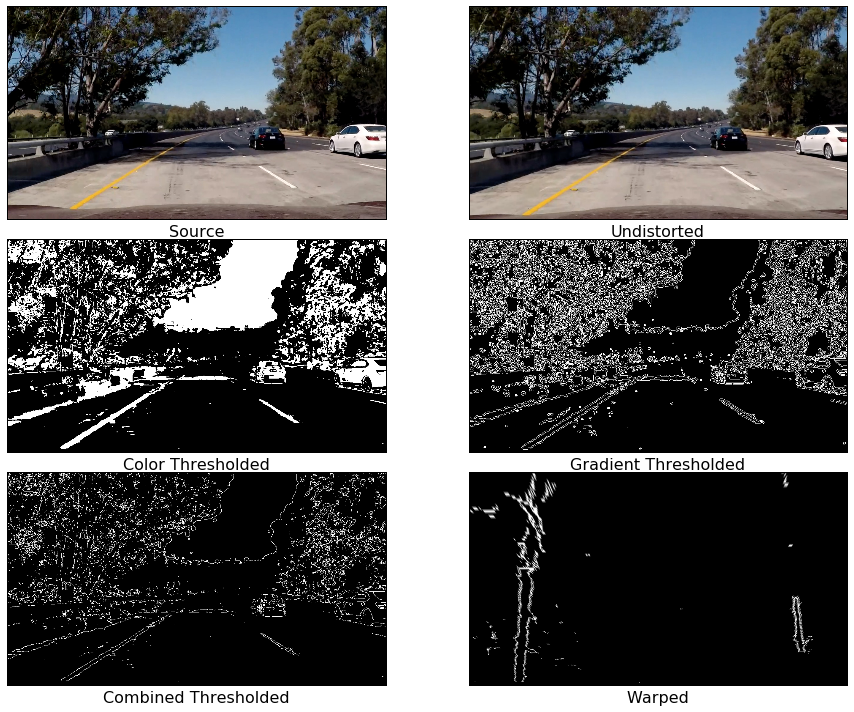

In [9]:
path = "test_images/"
file = "test5.jpg"
img = cv2.imread(path+file)
undist = undistort_img(img)
color_thresholded = color_threshold(undist)
grad_thresholded = applythresholds(color_thresholded)
combined_thresholded = combinethresh(grad_thresholded, color_thresholded)
warped_img, M, Minv = perspective_transform(combined_thresholded)


# image processing
processed_images = plt.figure(figsize=(14,10))

axis = processed_images.add_subplot(3,2,1)
axis.set_xlabel("Source", fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

axis = processed_images.add_subplot(3,2,2)
axis.set_xlabel("Undistorted",fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))

axis = processed_images.add_subplot(3,2,3)
axis.set_xlabel("Color Thresholded",fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(color_thresholded, cmap="gray")

axis = processed_images.add_subplot(3,2,4)
axis.set_xlabel("Gradient Thresholded",fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(grad_thresholded, cmap="gray")

axis = processed_images.add_subplot(3,2,5)
axis.set_xlabel("Combined Thresholded",fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(combined_thresholded, cmap="gray")

axis = processed_images.add_subplot(3,2,6)
axis.set_xlabel("Warped",fontsize=16)
plt.xticks(np.array([]))
plt.yticks(np.array([]))
axis.imshow(warped_img, cmap="gray")

processed_images.tight_layout(h_pad=0, w_pad=0)
processed_images.savefig('output_images/processed_images.png')

## Locate the Lane Lines and Fit a Polynomial ##


In [10]:
def fit_polynomials(binary_warped):
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    cv2.imwrite('output_images/fitpolynomial.jpg', cv2.cvtColor(np.float32(out_img), cv2.COLOR_RGB2BGR))
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
    
    return ploty, lefty, righty, leftx, rightx, left_fitx, right_fitx
    


### Calculate Curvature And Offset

In [11]:
def calculate_curvature_offset(ploty, lefty, righty, leftx, rightx, w, h):
    y_eval = np.max(ploty)
    lane_width_pix = w * 0.57
    ym_per_pix = 23/h # meters per pixel in y dimension
    xm_per_pix = 3.7/lane_width_pix # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    curvrad = np.mean([left_curverad, right_curverad])
    
    image_centre = lane_width_pix * xm_per_pix / 2
    
    vehicle_centre = np.mean([left_fit_cr, right_fit_cr])
    
    vehicle_offset = abs(image_centre - vehicle_centre)
    
    return curvrad, vehicle_offset

### Render the lane with the warped image

In [12]:
def render_lane(binary_warped, undist, Minv, ploty, left_fitx, right_fitx, curverad, vehicle_offset):
    # step 1: Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    img_size = (color_warp.shape[1], color_warp.shape[0])
    
    # step 2: Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # step 3: Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # step 4: Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, img_size)

    # step 5: Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    
    # step 6: print road position
    cv2.putText(result, 'Distance from centre (offset): {:.2f} m'.format(vehicle_offset), (100,80), fontFace = 16,\
                    fontScale = 1, color=(255,255,255), thickness = 2)
       
    # step 7: print curvature
    cv2.putText(result, 'Radius of Curvature {} m'.format(int(curverad)), (120,140),
             fontFace = 16, fontScale = 1, color=(255,255,255), thickness = 2)
    
    return result

## Locate Lane on a single image ##

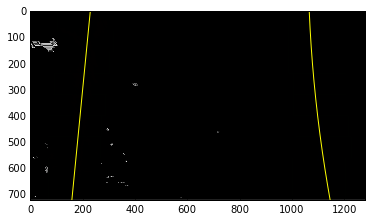

Radius of Curvature:  341127.777798 m
 Distance from the centre:  0.756398218829 m


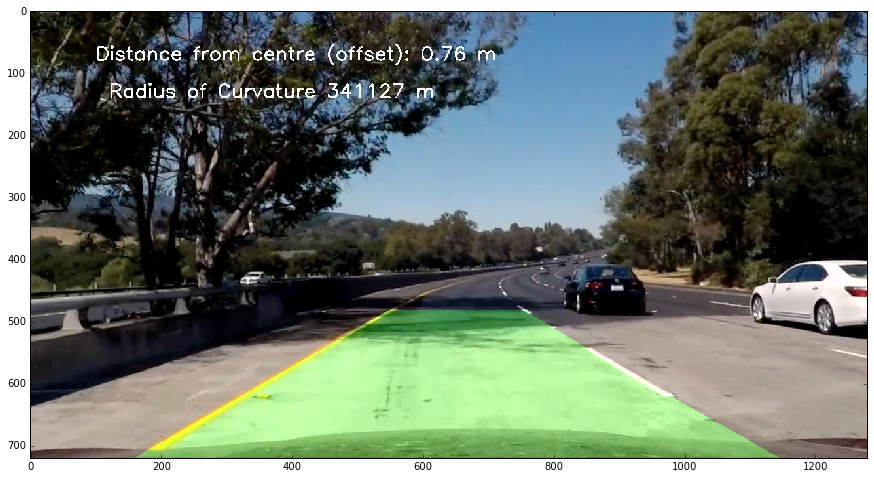

In [13]:
ploty, lefty, righty, leftx, rightx, left_fitx, right_fitx = fit_polynomials(warped_img)

#step1: Measurement of road curvature and offset
curverad, vehicle_offset = calculate_curvature_offset(ploty, lefty, righty, leftx, rightx, undist.shape[1], undist.shape[0])
print ("Radius of Curvature: ", curverad,"m\n", "Distance from the centre: ", vehicle_offset,"m")

#step2: render the lane on top of the original image
result = render_lane(warped_img, undist, Minv, ploty, left_fitx, right_fitx, curverad, vehicle_offset)

plt.subplots(figsize=(15, 8))
plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB),interpolation='nearest', aspect='auto')

## Advanced Lane detection Pipeline ##


In [ ]:
def advanced_lane_detection_pipeline(img):
    undist = undistort_img(img)
    color_thresholded = color_threshold(undist)
    grad_thresholded = applythresholds(color_thresholded)
    combined_thresholded = combinethresh(grad_thresholded, color_thresholded)
    warped_img, M, Minv = perspective_transform(combined_thresholded)
    
    #image_binary = detect_edges(image_transformed)
    
    ploty, lefty, righty, leftx, rightx, left_fitx, right_fitx = fit_polynomials(warped_img)
    curverad, vehicle_offset = calculate_curvature_offset(ploty, lefty, righty, leftx, rightx, undist.shape[1], undist.shape[0])
    result = render_lane(warped_img, undist, Minv, ploty, left_fitx, right_fitx, curverad, vehicle_offset)
    return result
    

## Video Processing ##
In the following section, the video was provided to the processing pipeline and the Lane Line Detection was carried out in the output video.

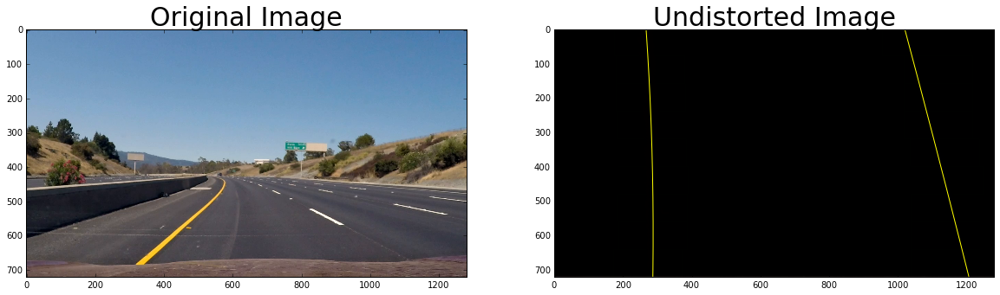

[MoviePy] >>>> Building video project_video_processed.mp4
[MoviePy] Writing video project_video_processed.mp4


  0%|          | 0/1261 [00:00<?, ?it/s]

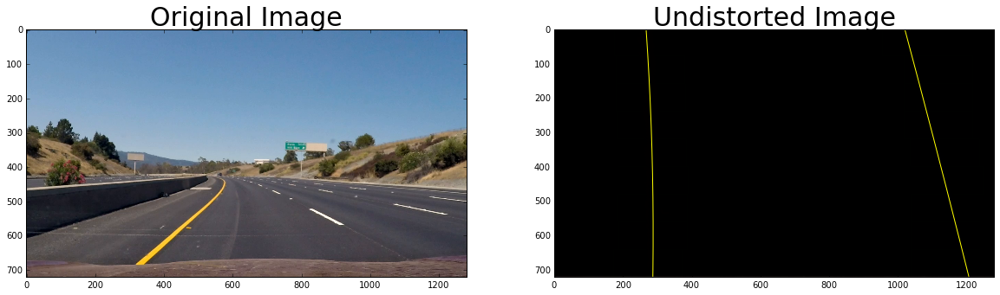

  0%|          | 1/1261 [00:02<55:19,  2.63s/it]

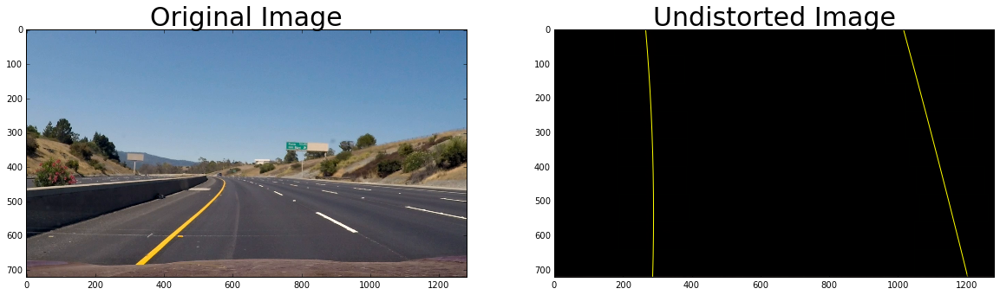

  0%|          | 2/1261 [00:05<55:33,  2.65s/it]

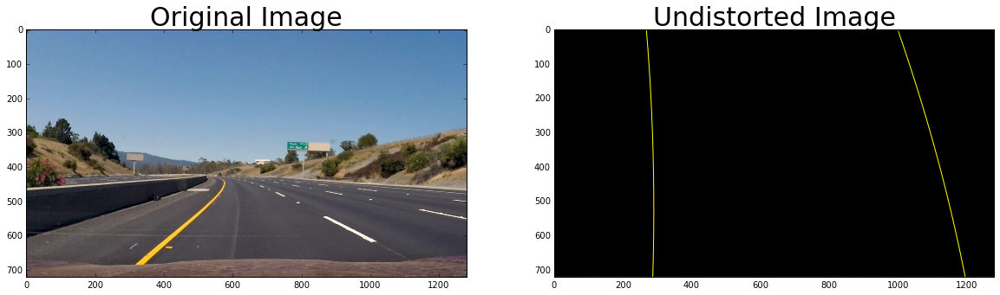

  0%|          | 3/1261 [00:07<55:04,  2.63s/it]

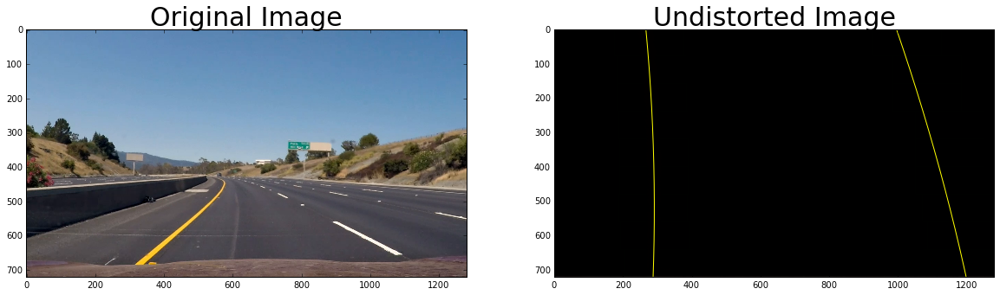

  0%|          | 4/1261 [00:10<54:48,  2.62s/it]

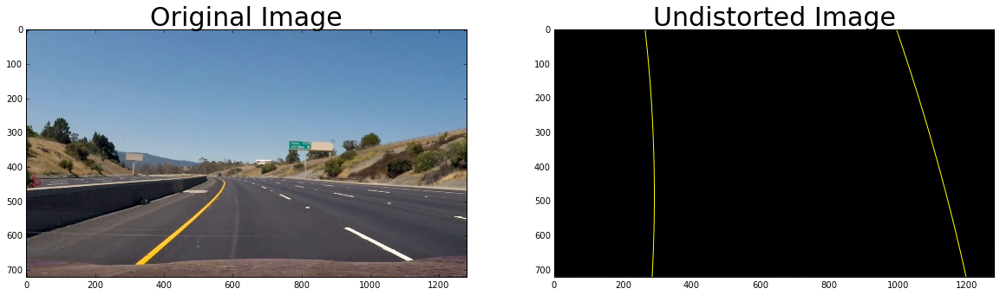

  0%|          | 5/1261 [00:13<54:18,  2.59s/it]

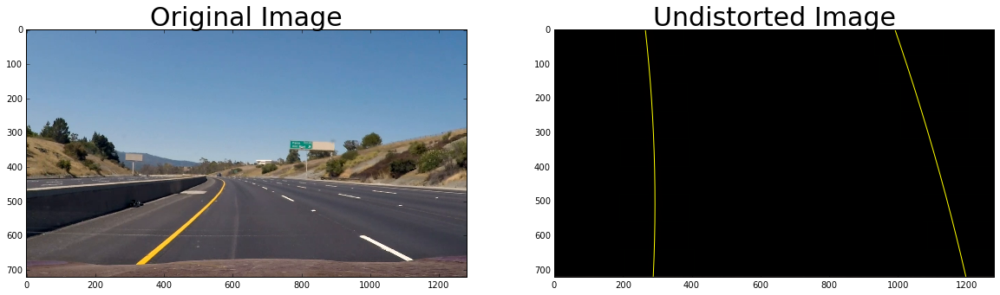

  0%|          | 6/1261 [00:15<53:35,  2.56s/it]

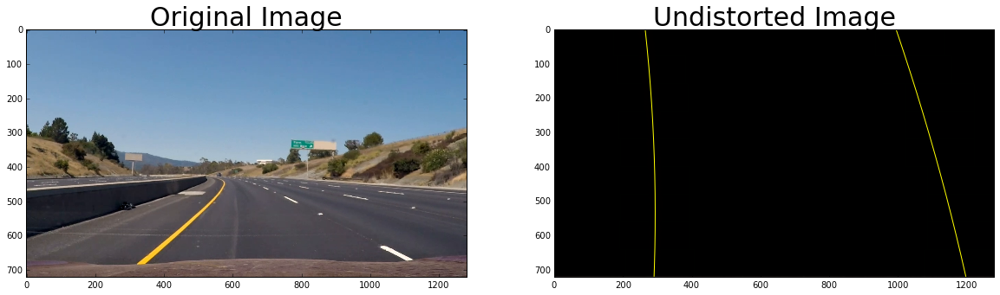

  1%|          | 7/1261 [00:18<53:54,  2.58s/it]

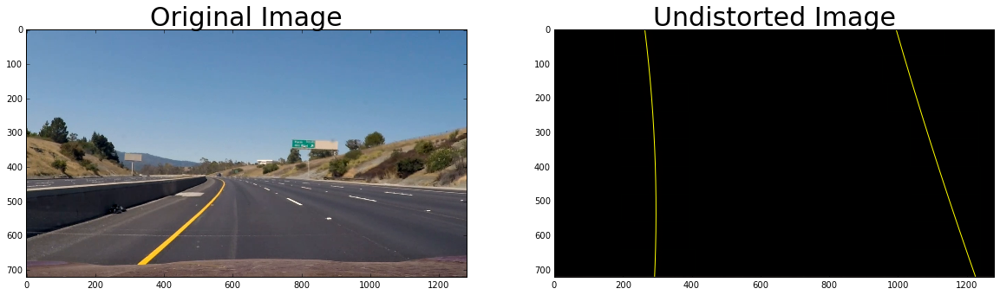

  1%|          | 8/1261 [00:20<53:01,  2.54s/it]

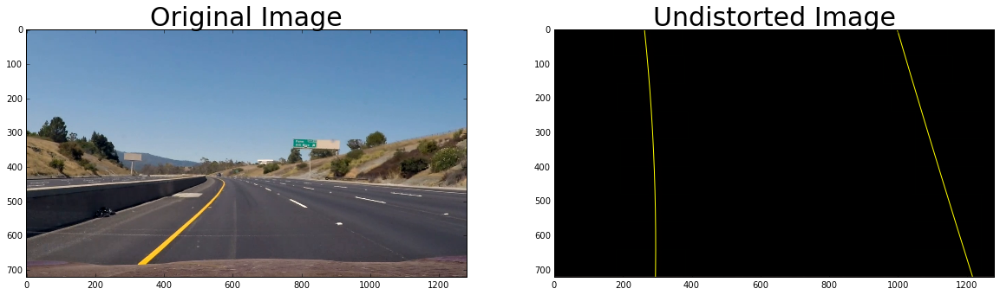

  1%|          | 9/1261 [00:22<52:11,  2.50s/it]

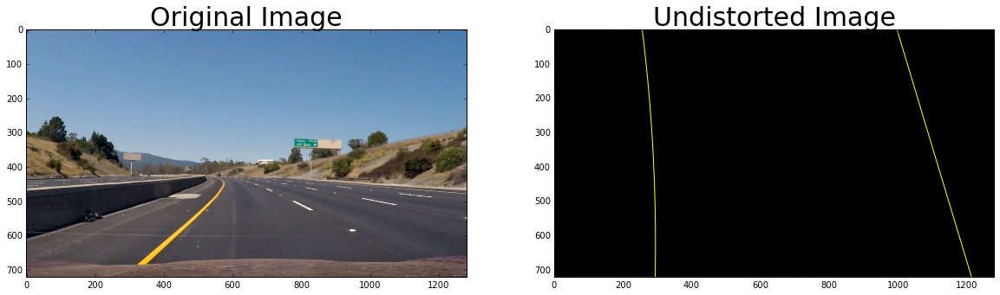

  1%|          | 10/1261 [00:25<53:06,  2.55s/it]

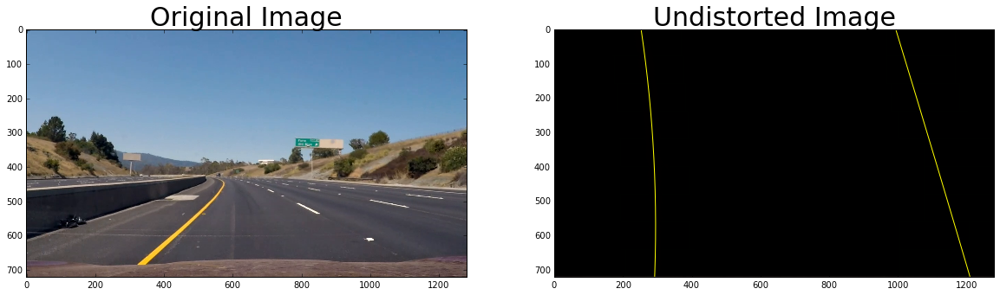

  1%|          | 11/1261 [00:28<52:52,  2.54s/it]

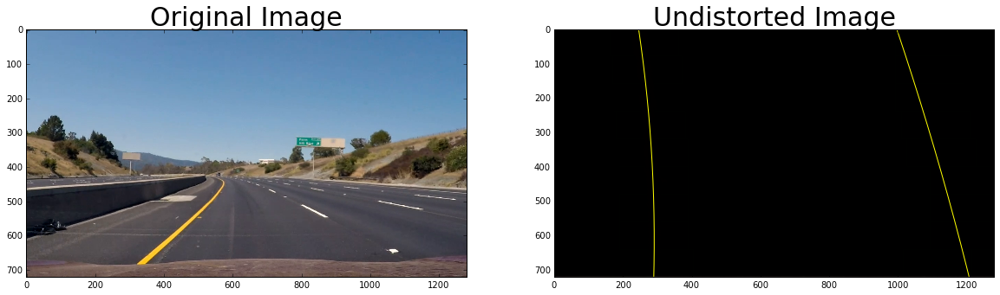

  1%|          | 12/1261 [00:30<52:26,  2.52s/it]

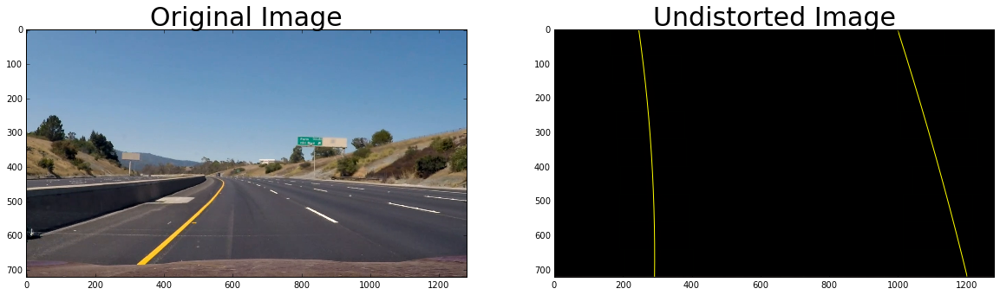

  1%|          | 13/1261 [00:33<51:53,  2.49s/it]

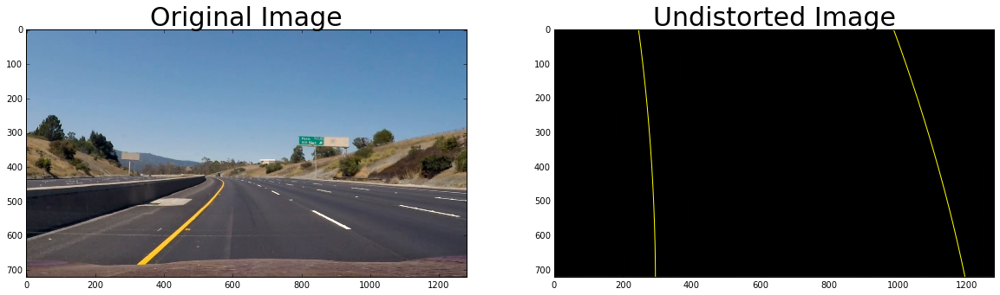

  1%|          | 14/1261 [00:35<52:46,  2.54s/it]

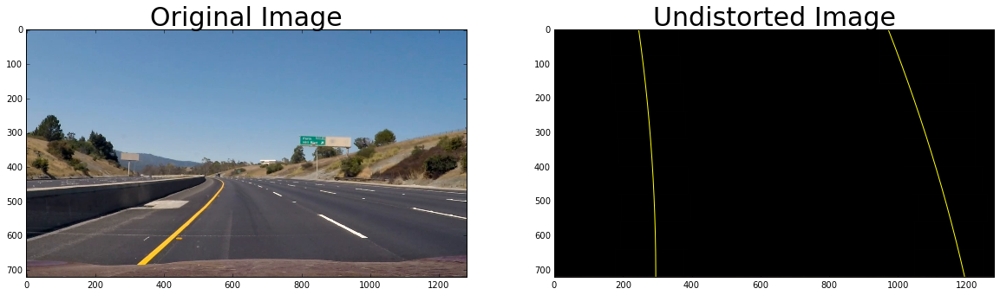

  1%|          | 15/1261 [00:38<52:30,  2.53s/it]

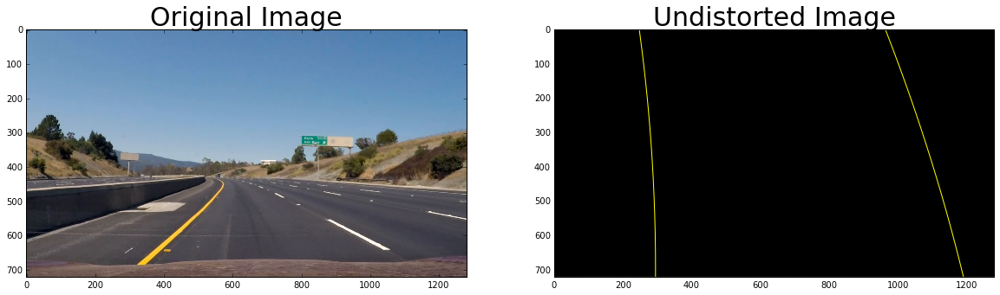

  1%|▏         | 16/1261 [00:40<51:53,  2.50s/it]

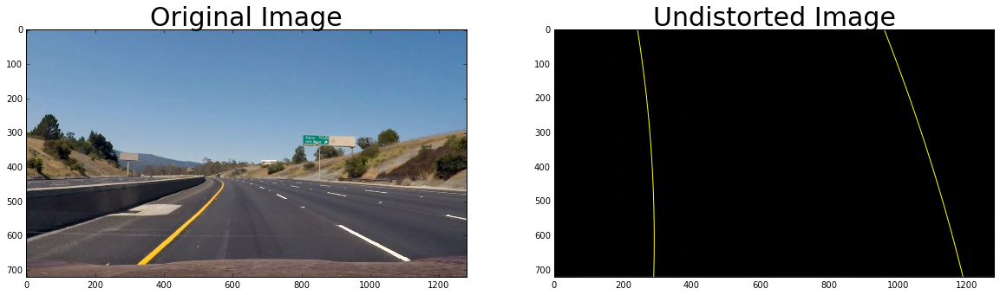

  1%|▏         | 17/1261 [00:43<52:15,  2.52s/it]

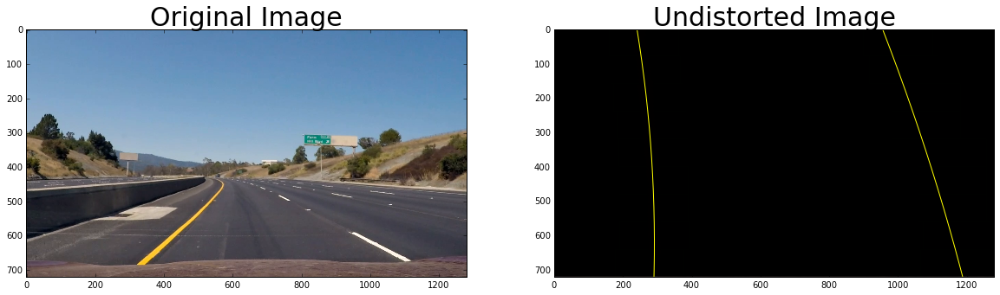

  1%|▏         | 18/1261 [00:45<52:39,  2.54s/it]

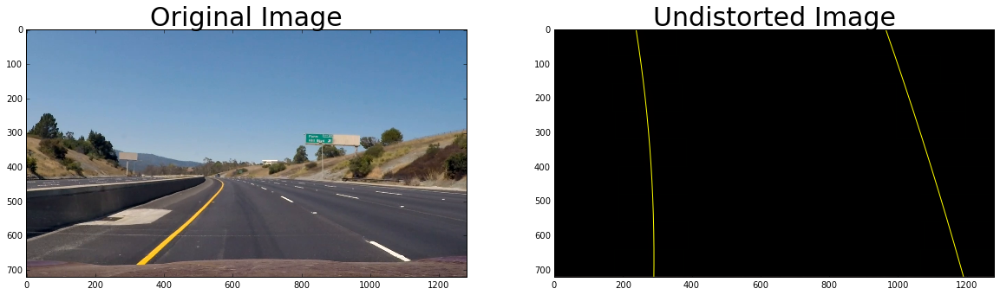

  2%|▏         | 19/1261 [00:48<52:14,  2.52s/it]

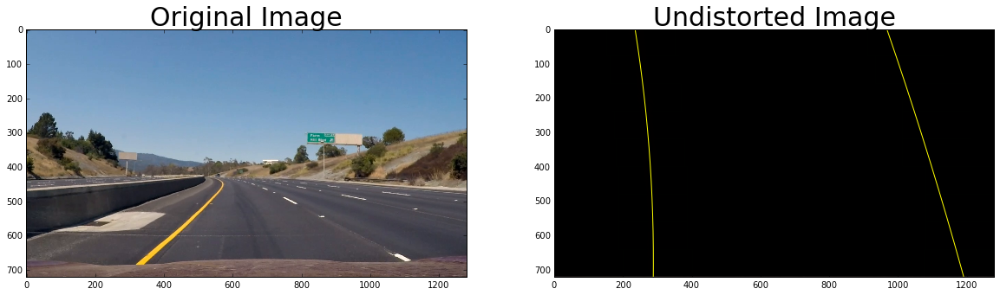

  2%|▏         | 20/1261 [00:50<52:03,  2.52s/it]

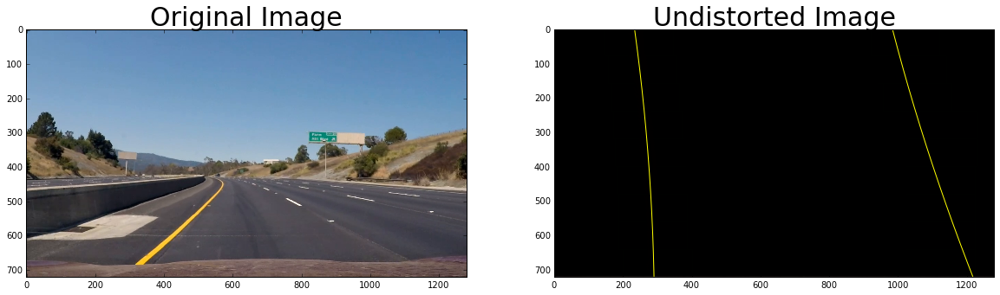

  2%|▏         | 21/1261 [00:53<51:39,  2.50s/it]

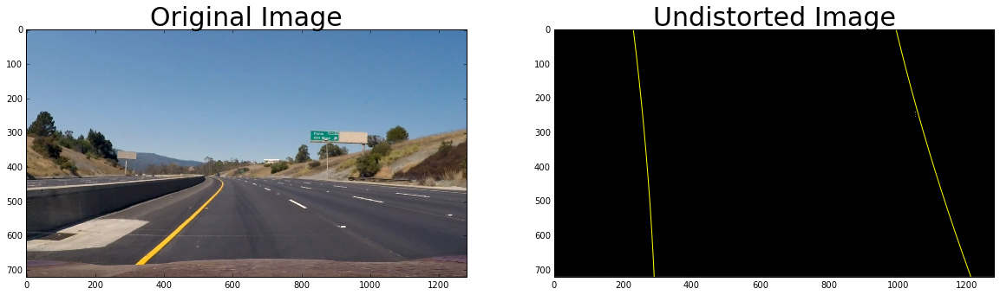

  2%|▏         | 22/1261 [00:55<52:03,  2.52s/it]

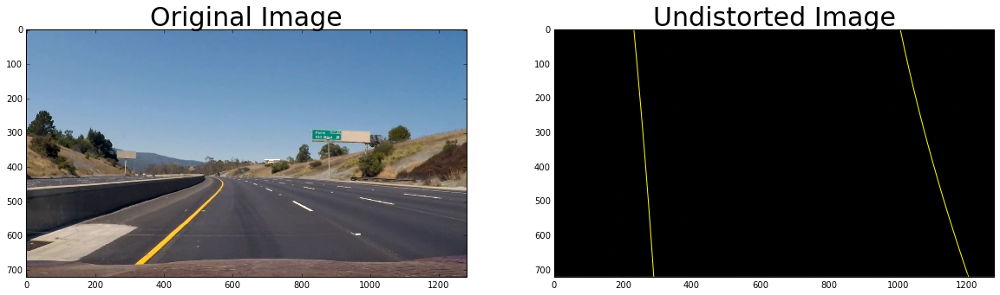

  2%|▏         | 23/1261 [00:58<52:13,  2.53s/it]

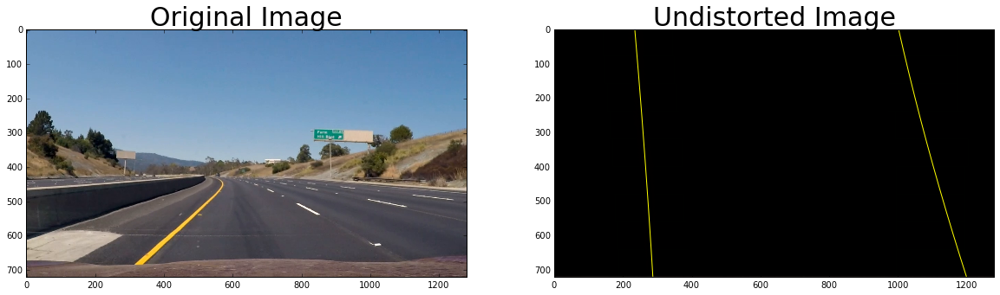

  2%|▏         | 24/1261 [01:00<51:31,  2.50s/it]

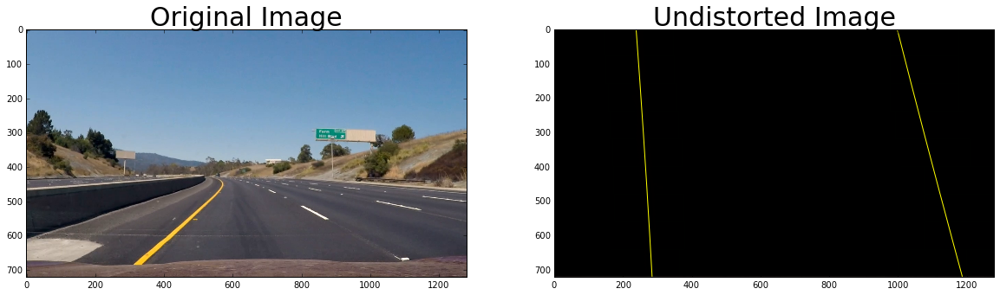

  2%|▏         | 25/1261 [01:03<52:24,  2.54s/it]

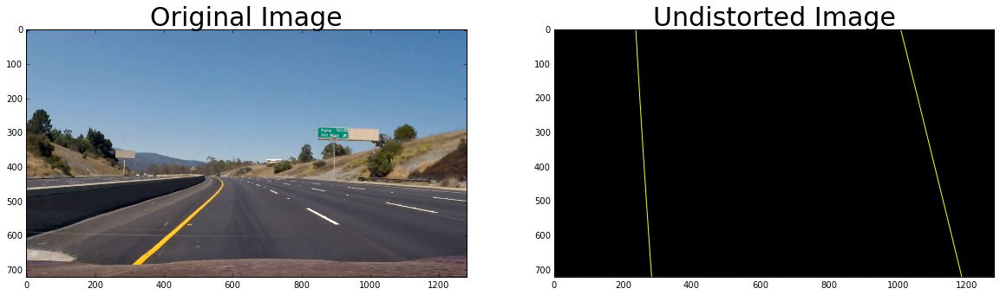

  2%|▏         | 26/1261 [01:06<52:44,  2.56s/it]

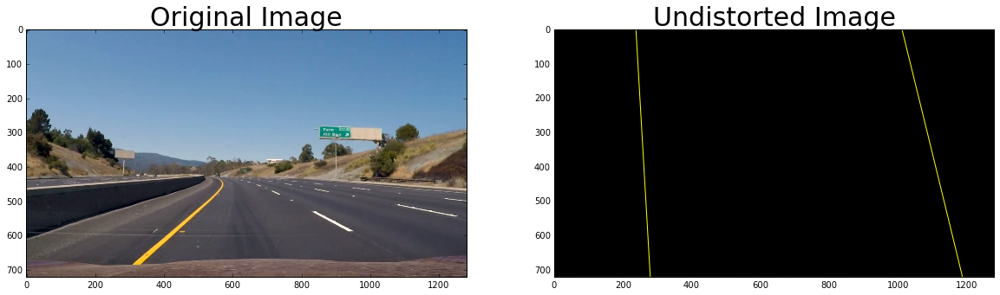

  2%|▏         | 27/1261 [01:08<52:04,  2.53s/it]

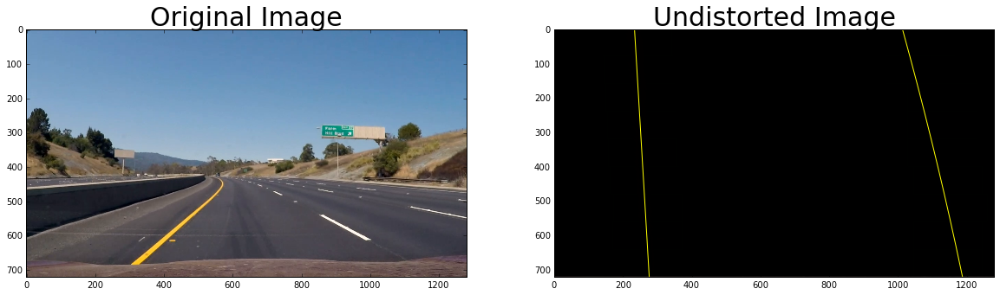

  2%|▏         | 28/1261 [01:11<51:47,  2.52s/it]

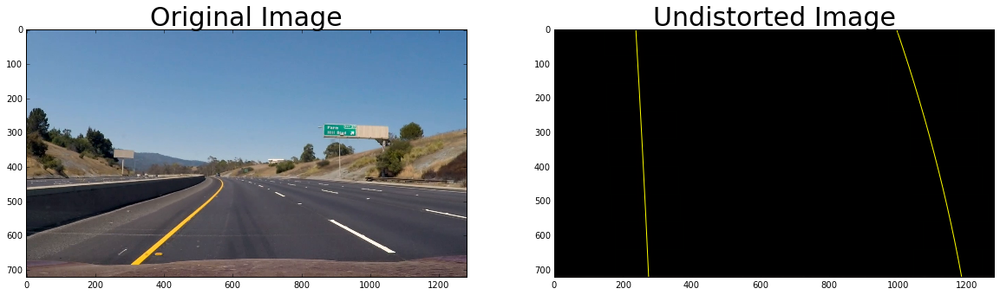

  2%|▏         | 29/1261 [01:13<51:56,  2.53s/it]

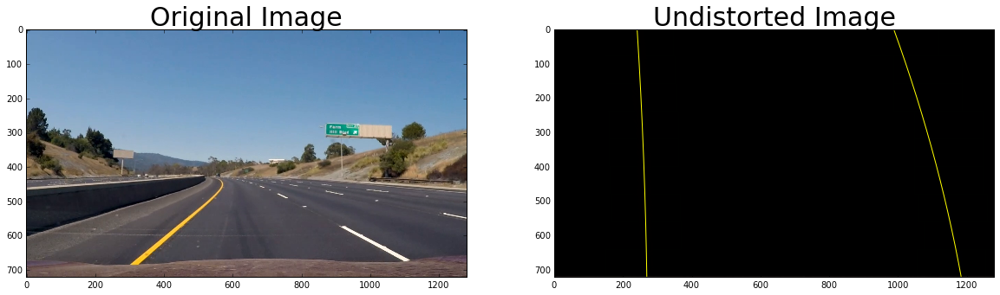

  2%|▏         | 30/1261 [01:16<51:18,  2.50s/it]

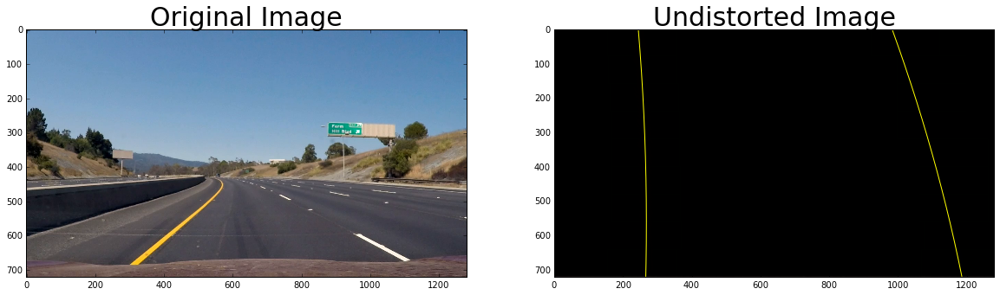

  2%|▏         | 31/1261 [01:18<51:43,  2.52s/it]

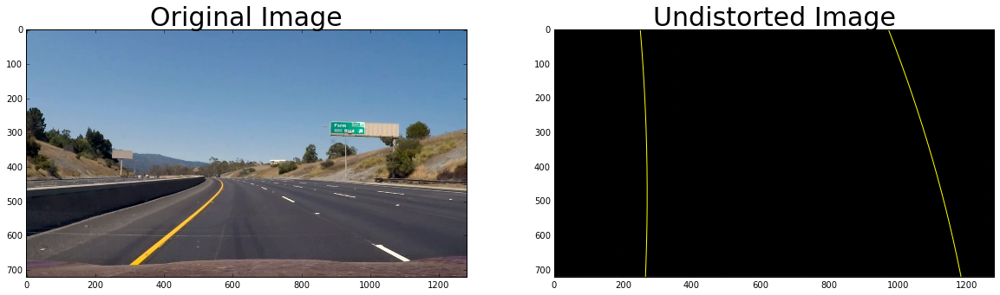

  3%|▎         | 32/1261 [01:20<50:50,  2.48s/it]

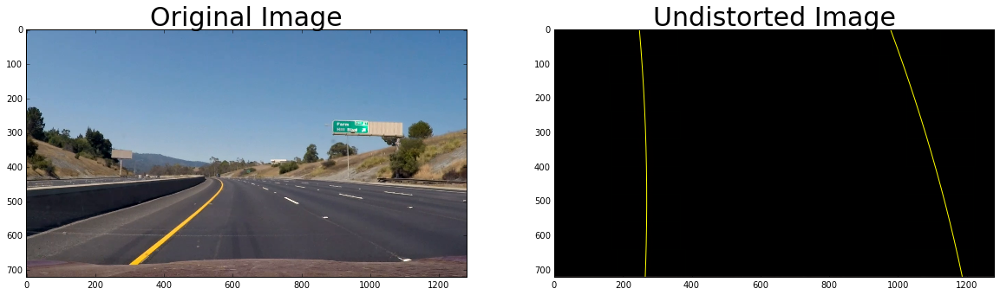

  3%|▎         | 33/1261 [01:23<50:31,  2.47s/it]

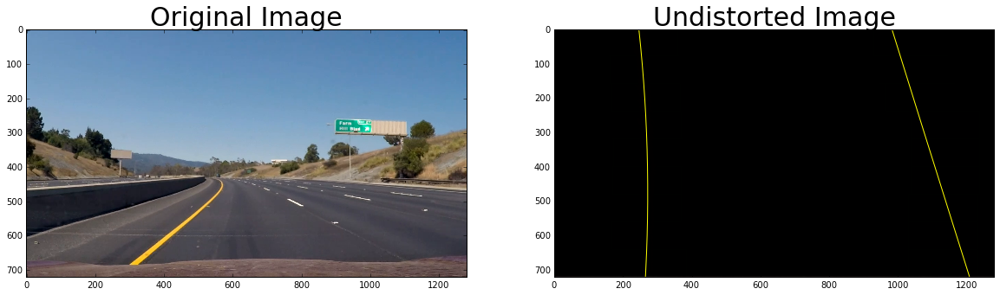

  3%|▎         | 34/1261 [01:25<50:55,  2.49s/it]

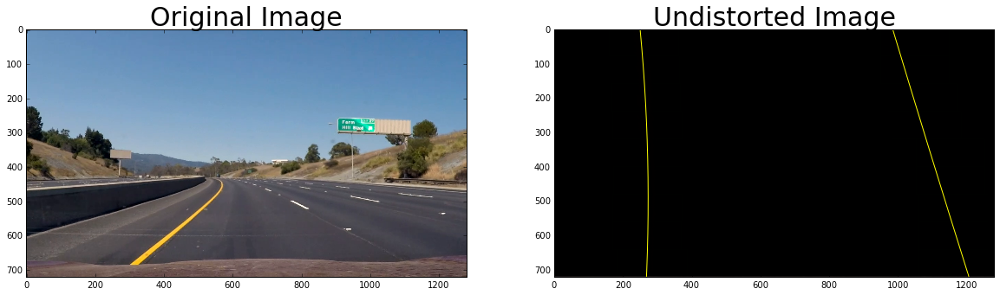

  3%|▎         | 35/1261 [01:28<50:34,  2.48s/it]

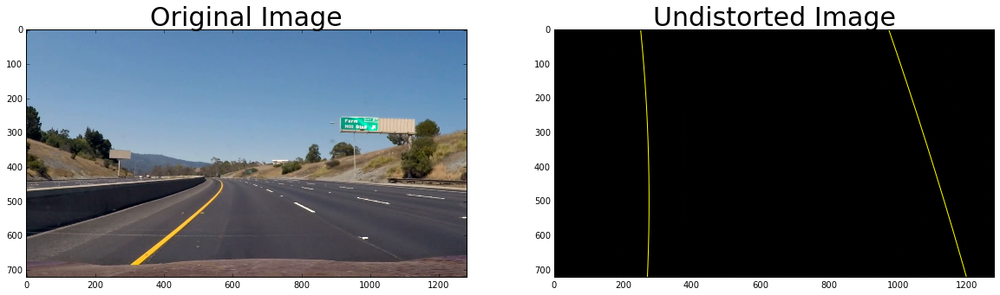

  3%|▎         | 36/1261 [01:30<50:43,  2.48s/it]

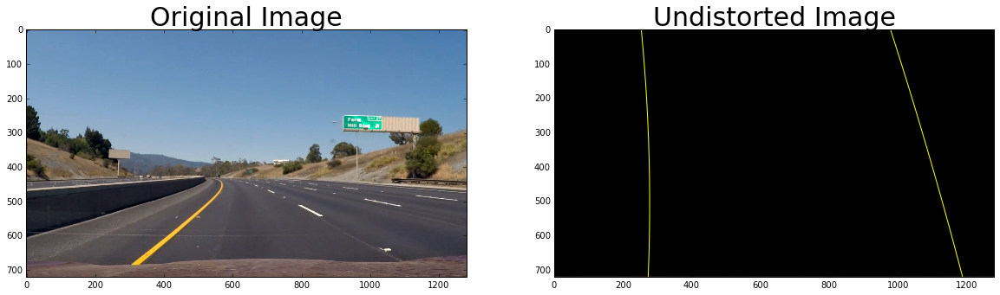

  3%|▎         | 37/1261 [01:33<51:12,  2.51s/it]

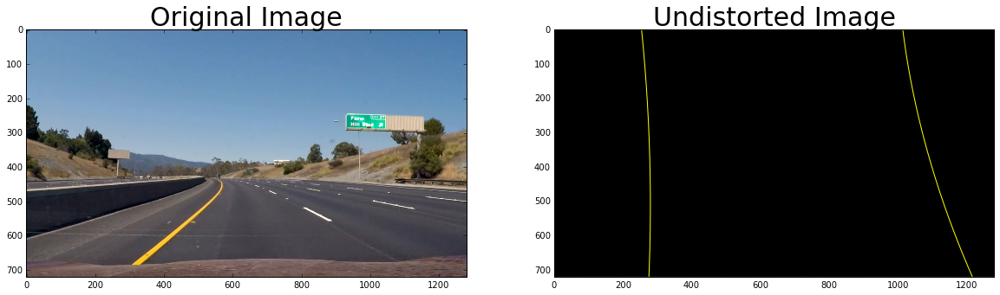

  3%|▎         | 38/1261 [01:35<50:50,  2.49s/it]

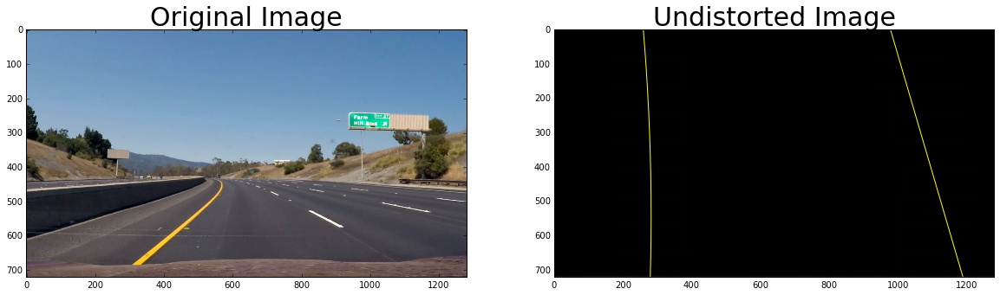

  3%|▎         | 39/1261 [01:38<51:09,  2.51s/it]

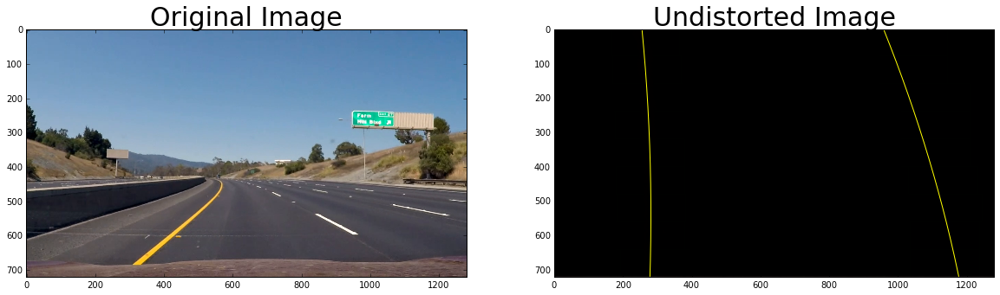

  3%|▎         | 40/1261 [01:41<51:34,  2.53s/it]

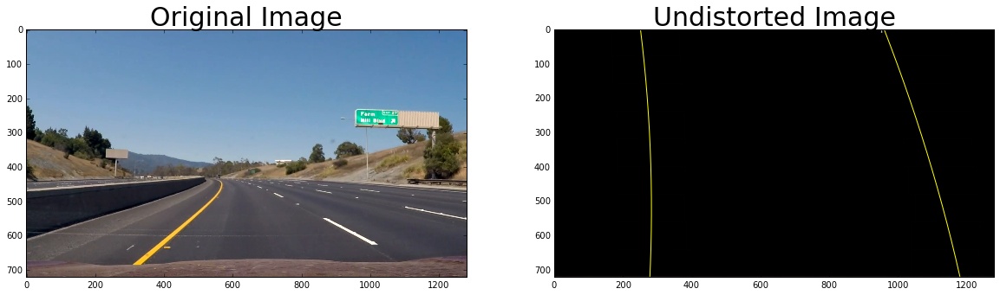

  3%|▎         | 41/1261 [01:43<51:46,  2.55s/it]

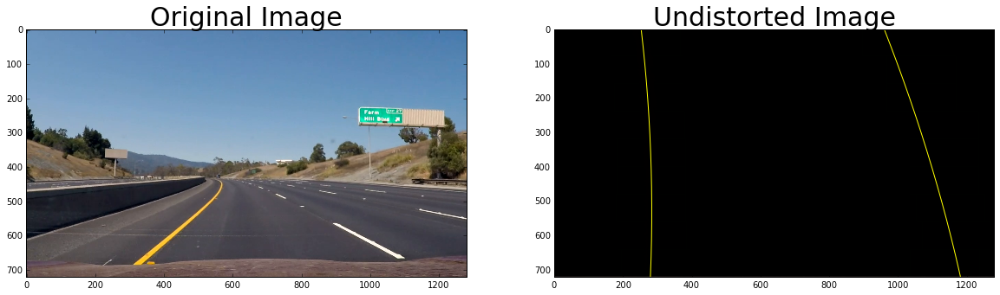

  3%|▎         | 42/1261 [01:46<51:35,  2.54s/it]

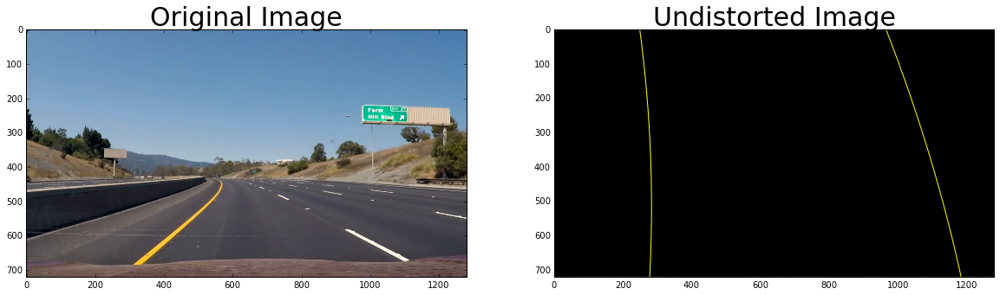

  3%|▎         | 43/1261 [01:48<51:39,  2.54s/it]

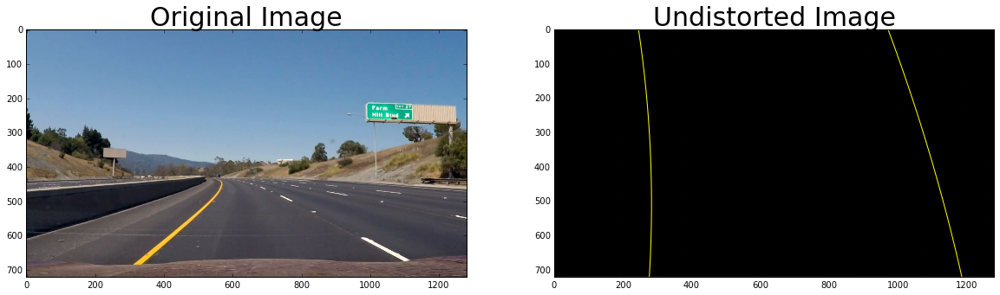

  3%|▎         | 44/1261 [01:51<51:27,  2.54s/it]

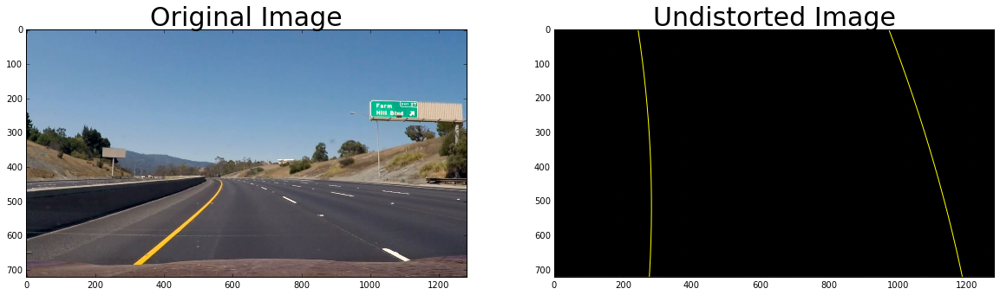

  4%|▎         | 45/1261 [01:53<52:15,  2.58s/it]

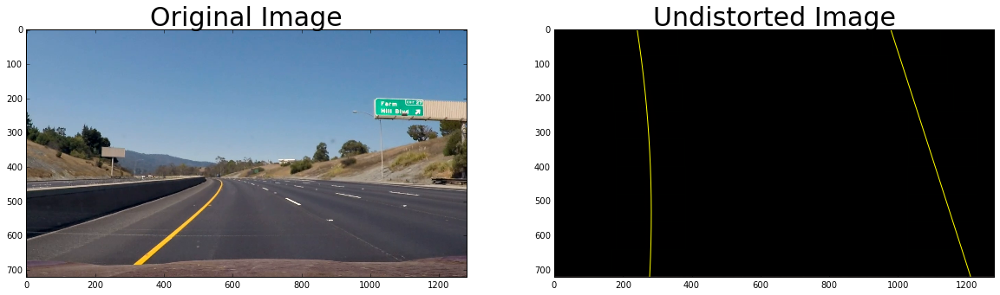

  4%|▎         | 46/1261 [01:56<51:40,  2.55s/it]

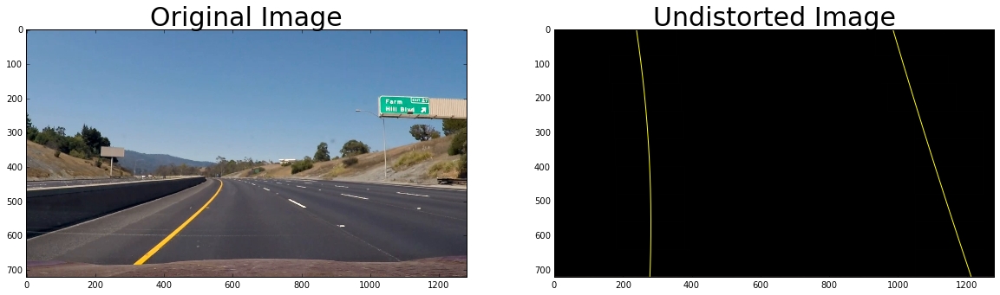

  4%|▎         | 47/1261 [01:58<51:40,  2.55s/it]

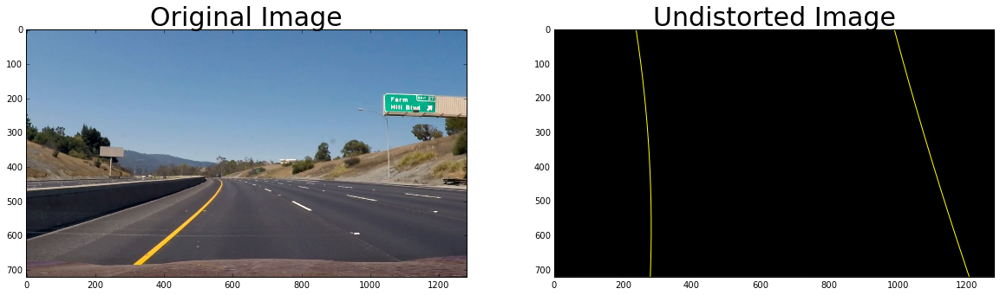

  4%|▍         | 48/1261 [02:01<51:24,  2.54s/it]

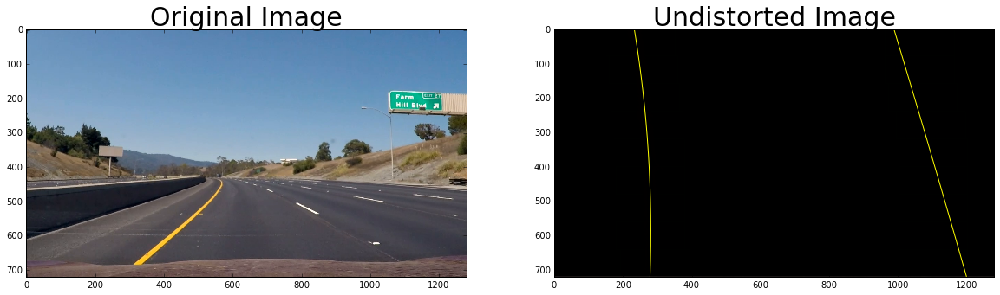

  4%|▍         | 49/1261 [02:03<50:55,  2.52s/it]

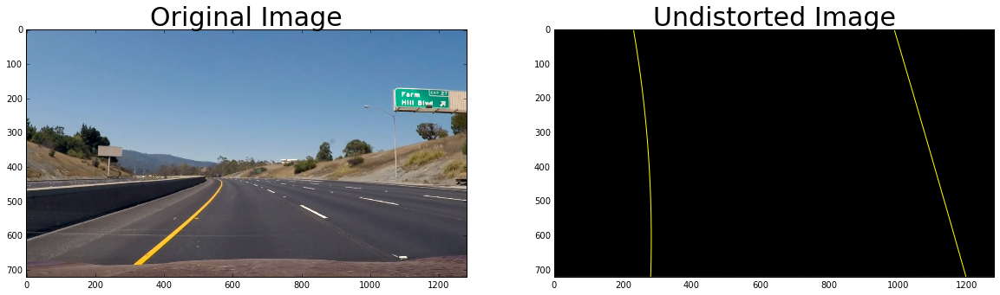

  4%|▍         | 50/1261 [02:06<51:05,  2.53s/it]

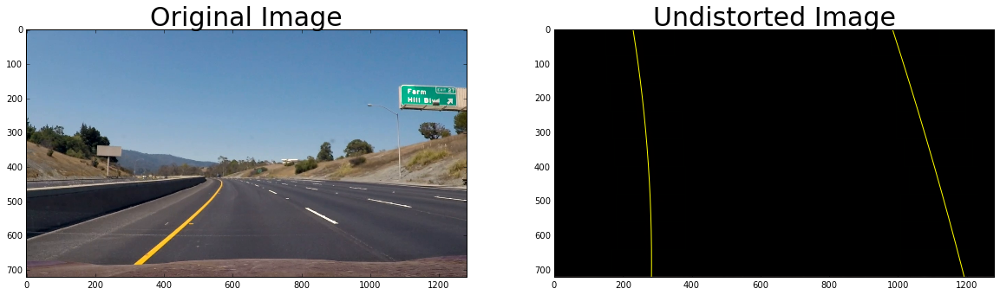

  4%|▍         | 51/1261 [02:09<52:27,  2.60s/it]

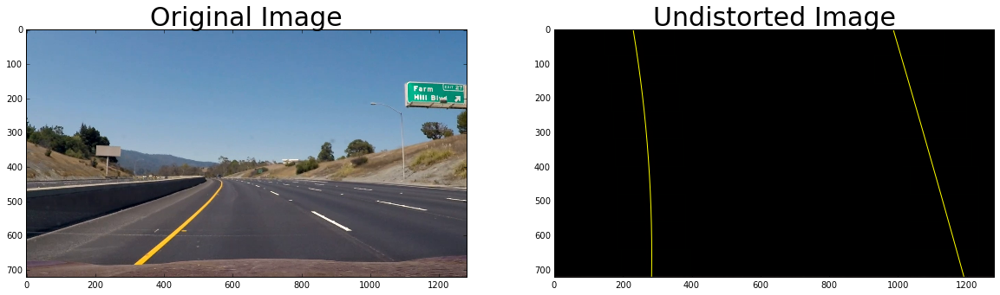

  4%|▍         | 52/1261 [02:11<51:58,  2.58s/it]

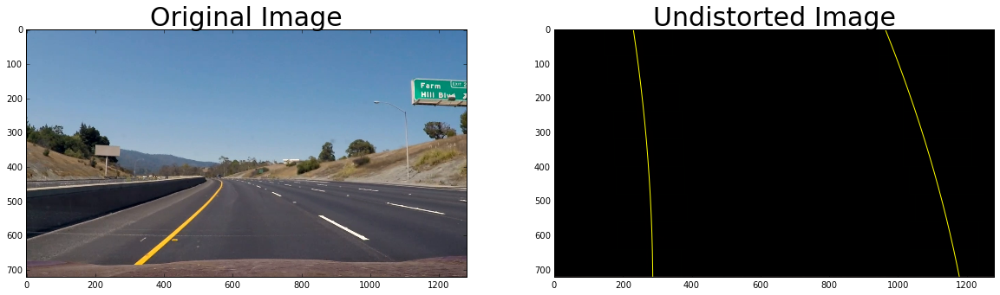

  4%|▍         | 53/1261 [02:14<51:56,  2.58s/it]

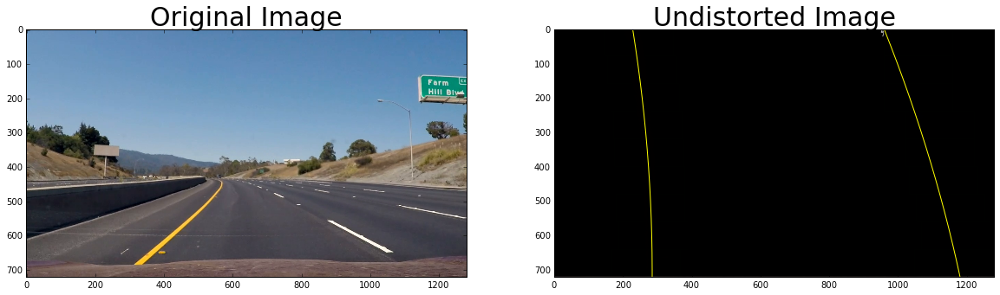

  4%|▍         | 54/1261 [02:16<51:33,  2.56s/it]

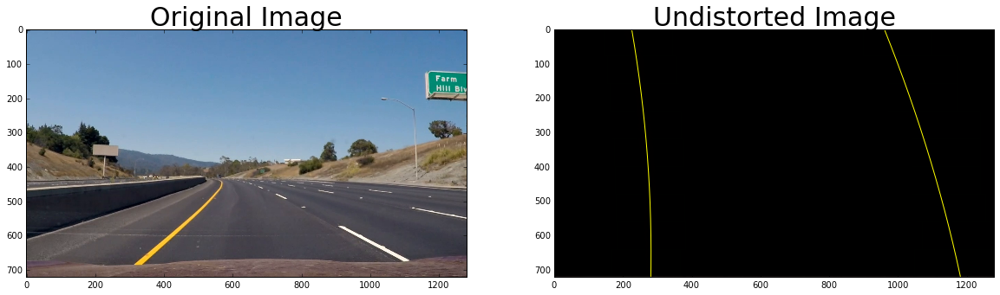

  4%|▍         | 55/1261 [02:19<52:14,  2.60s/it]

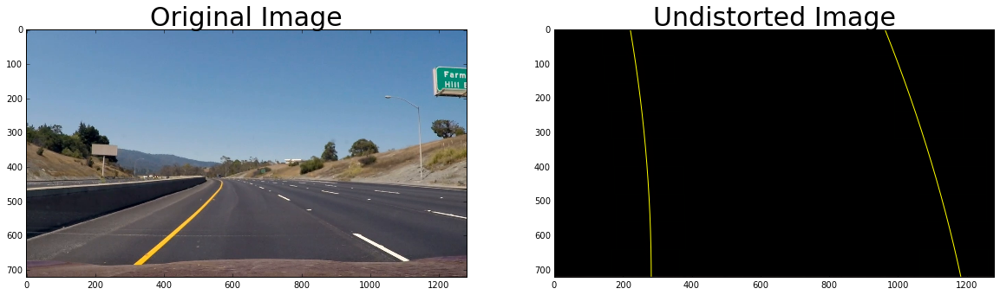

  4%|▍         | 56/1261 [02:22<52:20,  2.61s/it]

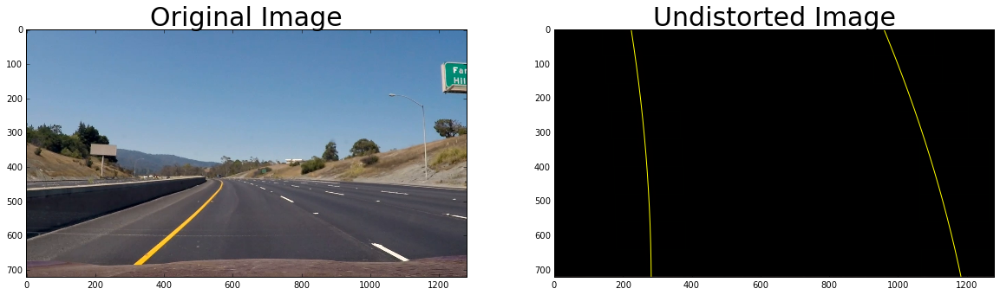

  5%|▍         | 57/1261 [02:24<51:21,  2.56s/it]

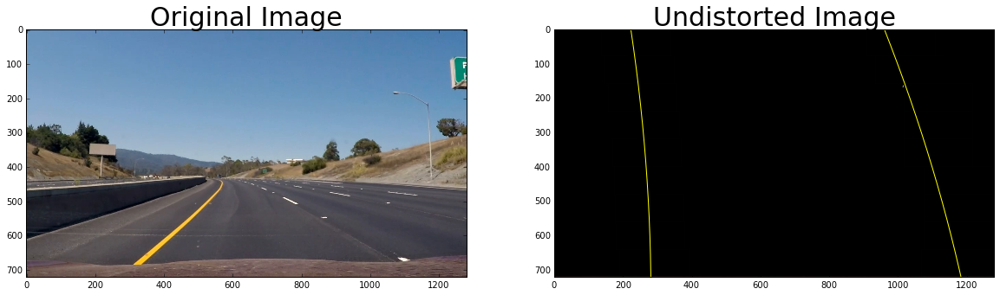

  5%|▍         | 58/1261 [02:27<50:36,  2.52s/it]

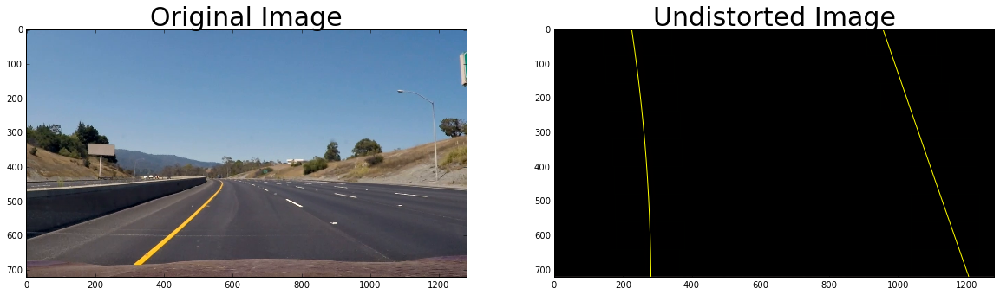

  5%|▍         | 59/1261 [02:29<50:29,  2.52s/it]

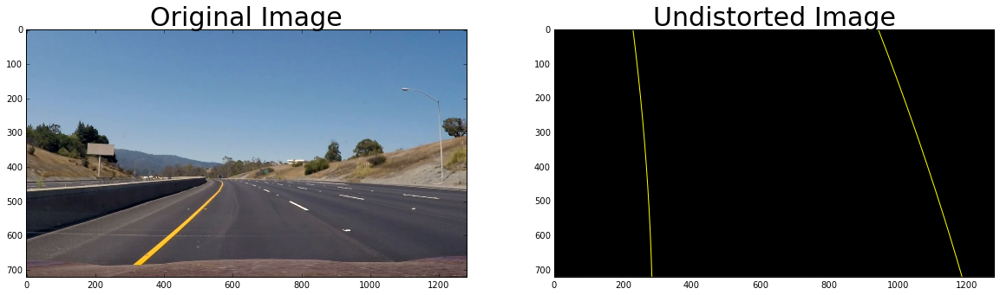

  5%|▍         | 60/1261 [02:32<50:15,  2.51s/it]

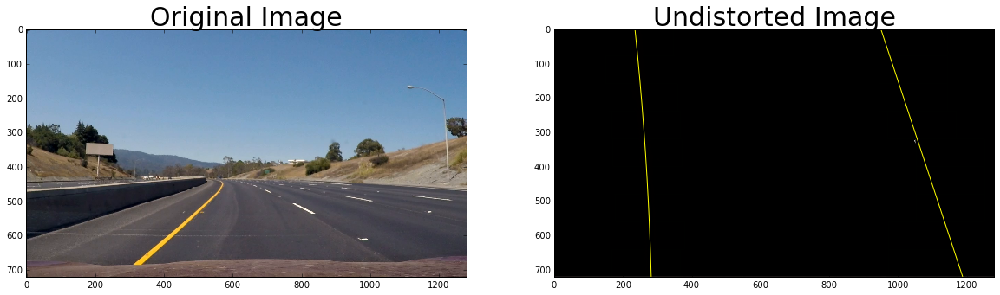

  5%|▍         | 61/1261 [02:34<50:26,  2.52s/it]

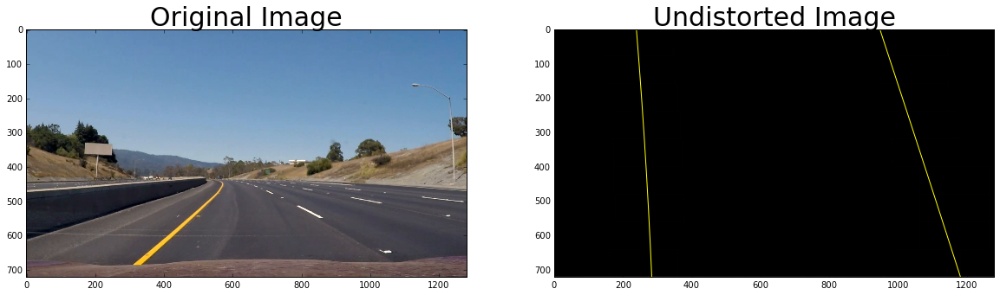

  5%|▍         | 62/1261 [02:37<51:09,  2.56s/it]

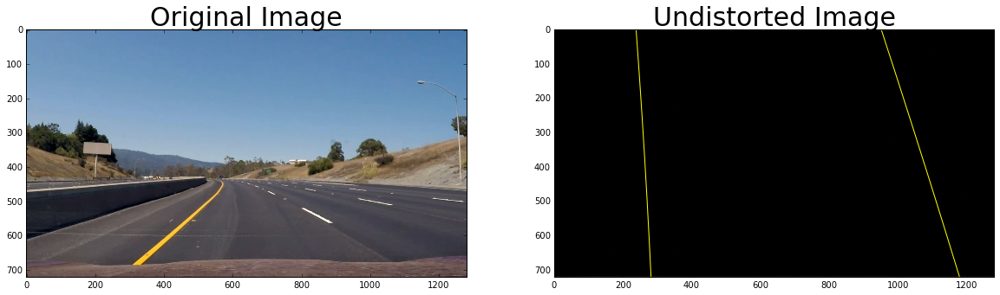

  5%|▍         | 63/1261 [02:39<50:24,  2.52s/it]

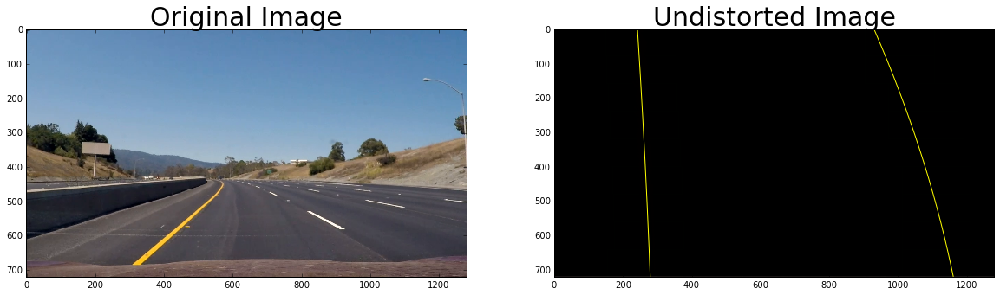

  5%|▌         | 64/1261 [02:42<50:18,  2.52s/it]

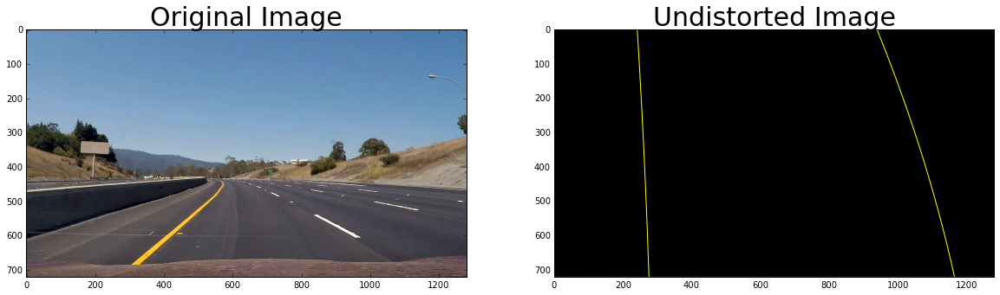

  5%|▌         | 65/1261 [02:44<49:52,  2.50s/it]

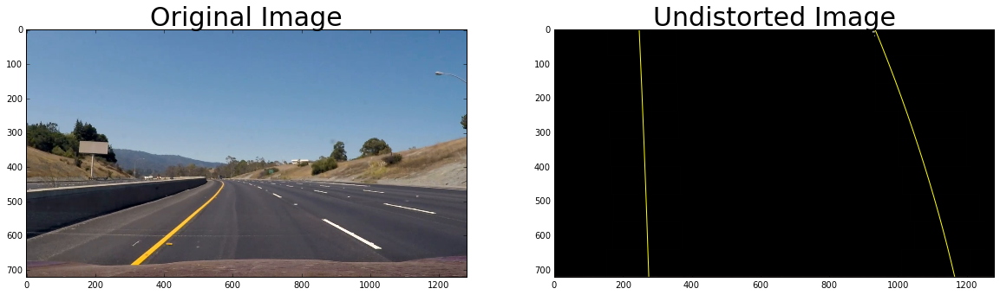

  5%|▌         | 66/1261 [02:47<50:02,  2.51s/it]

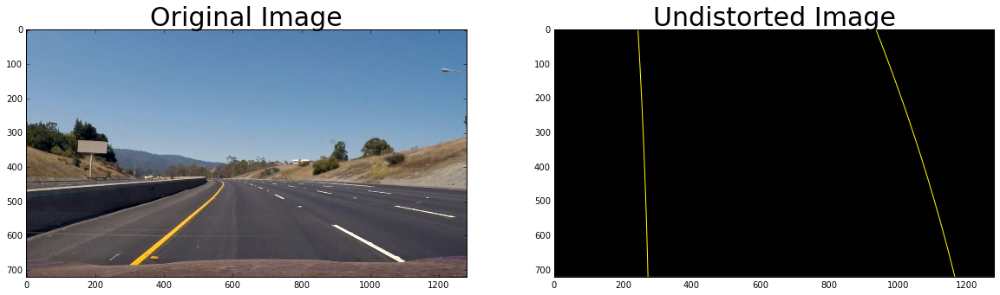

  5%|▌         | 67/1261 [02:49<50:56,  2.56s/it]

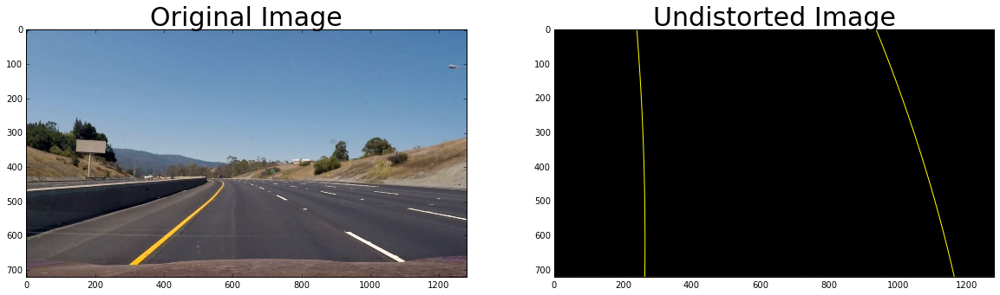

  5%|▌         | 68/1261 [02:52<50:10,  2.52s/it]

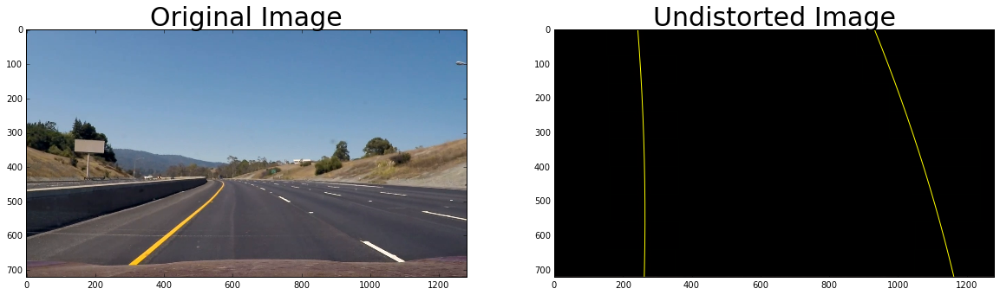

  5%|▌         | 69/1261 [02:54<49:54,  2.51s/it]

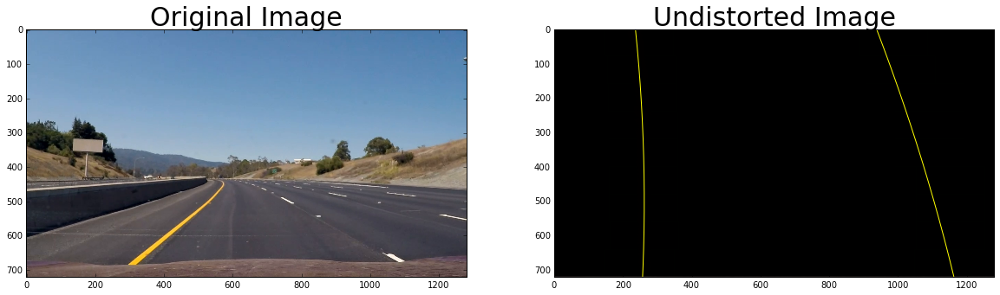

  6%|▌         | 70/1261 [02:57<49:52,  2.51s/it]

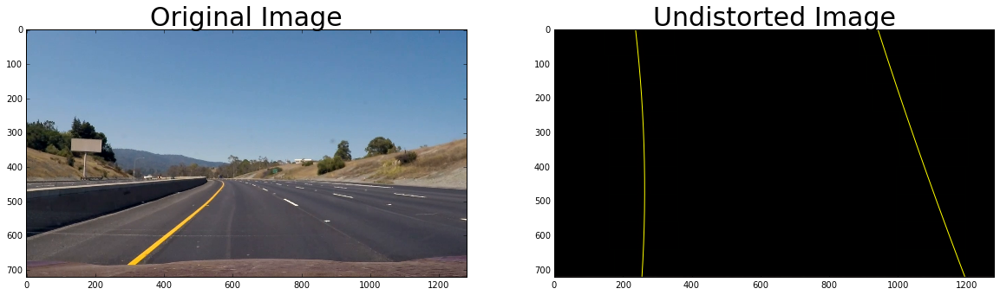

  6%|▌         | 71/1261 [02:59<49:38,  2.50s/it]

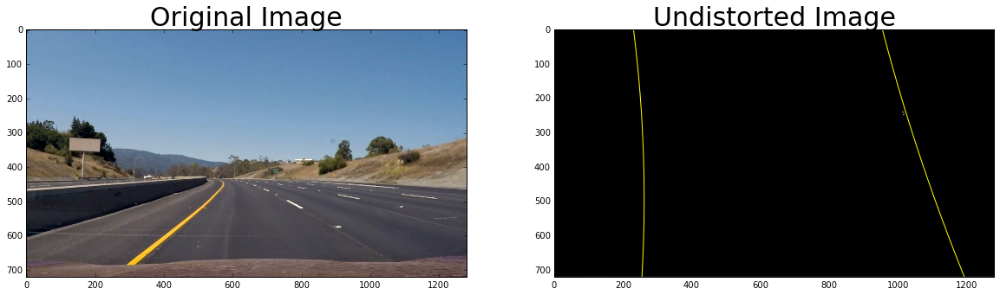

  6%|▌         | 72/1261 [03:02<49:14,  2.49s/it]

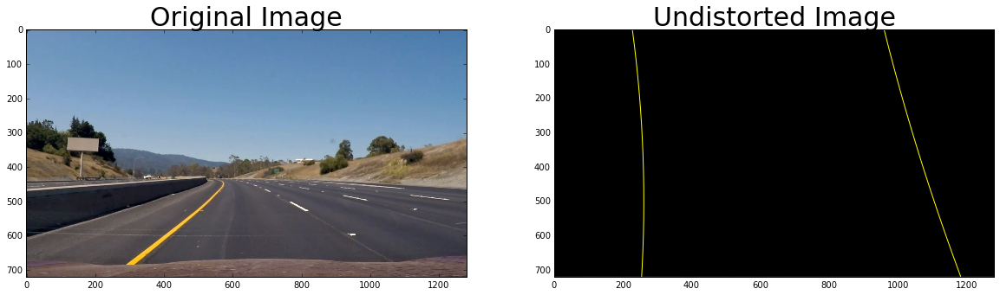

  6%|▌         | 73/1261 [03:04<50:15,  2.54s/it]

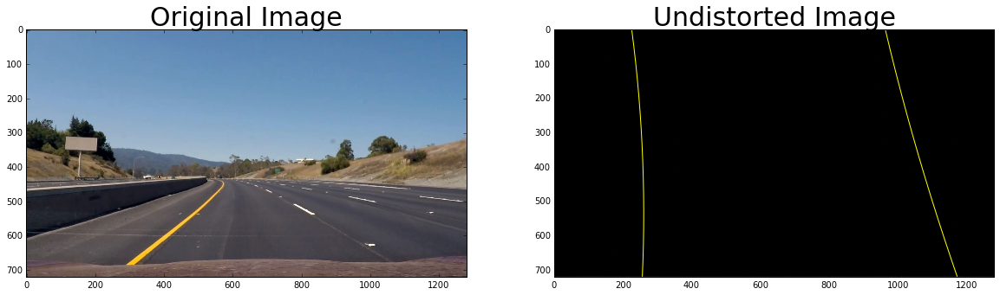

  6%|▌         | 74/1261 [03:07<49:36,  2.51s/it]

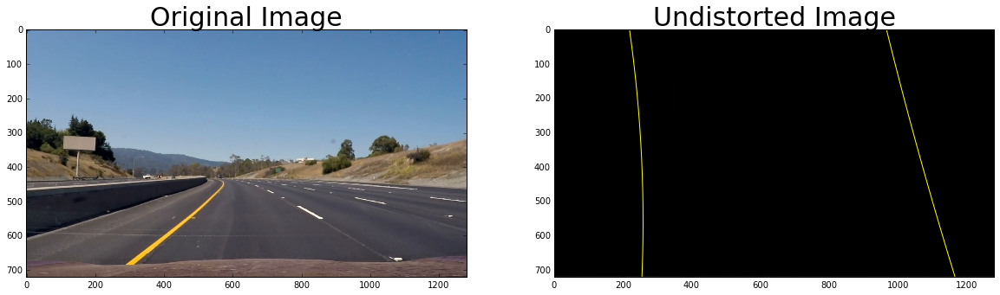

  6%|▌         | 75/1261 [03:09<49:57,  2.53s/it]

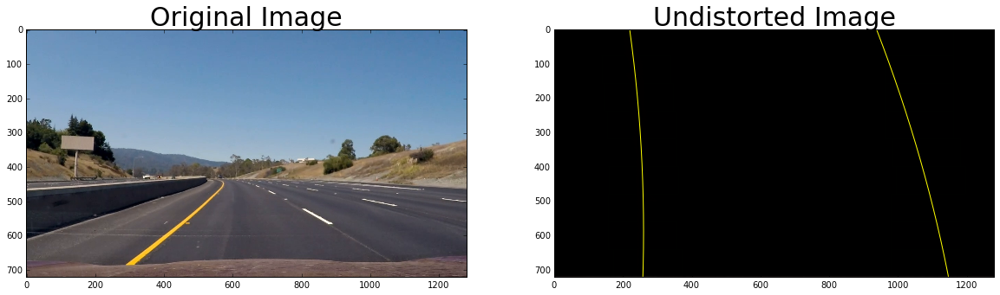

  6%|▌         | 76/1261 [03:12<49:25,  2.50s/it]

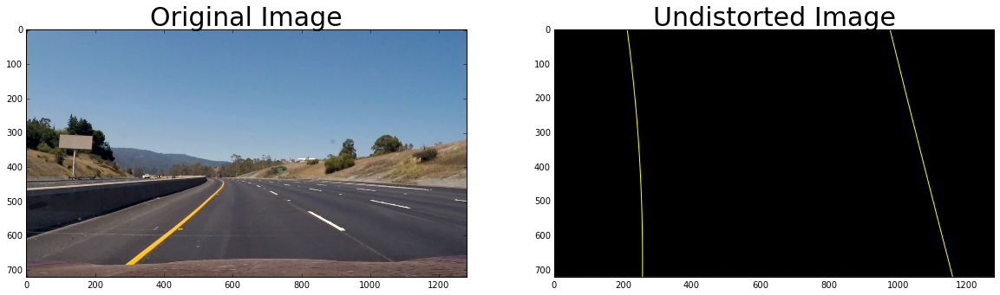

  6%|▌         | 77/1261 [03:14<49:06,  2.49s/it]

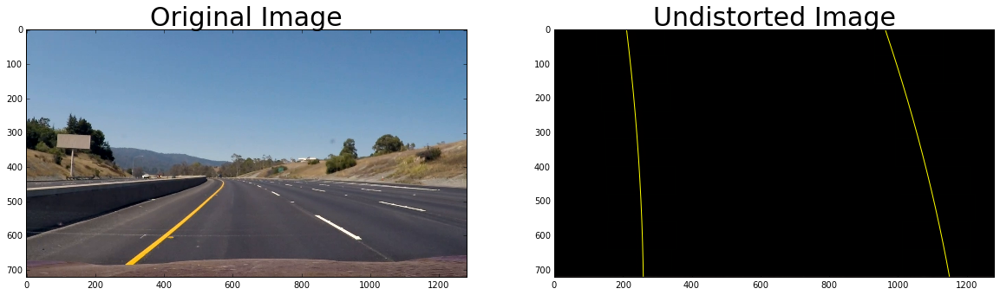

  6%|▌         | 78/1261 [03:17<49:38,  2.52s/it]

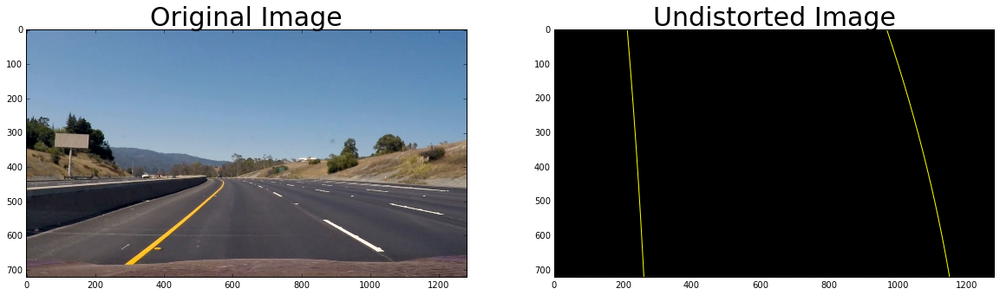

  6%|▋         | 79/1261 [03:19<49:41,  2.52s/it]

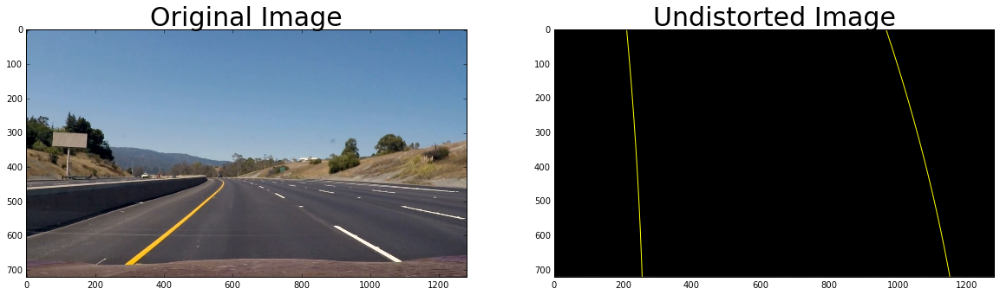

  6%|▋         | 80/1261 [03:22<49:41,  2.52s/it]

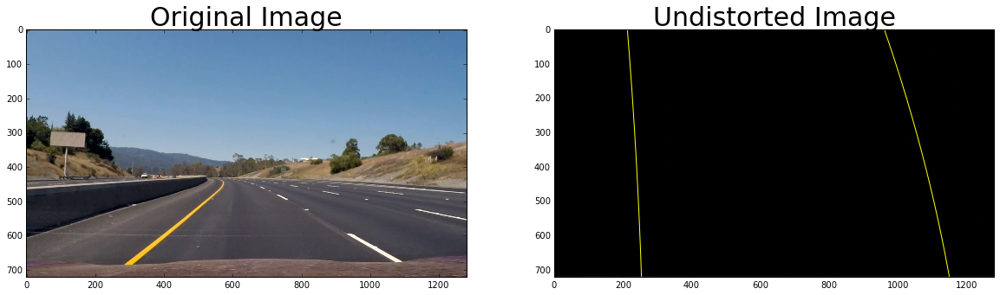

  6%|▋         | 81/1261 [03:25<50:15,  2.56s/it]

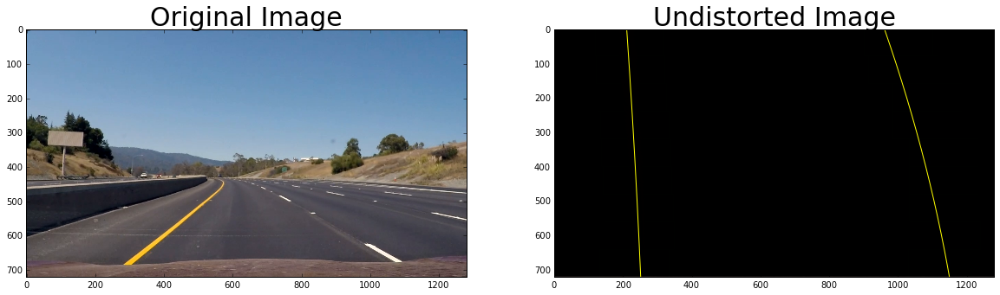

  7%|▋         | 82/1261 [03:27<49:52,  2.54s/it]

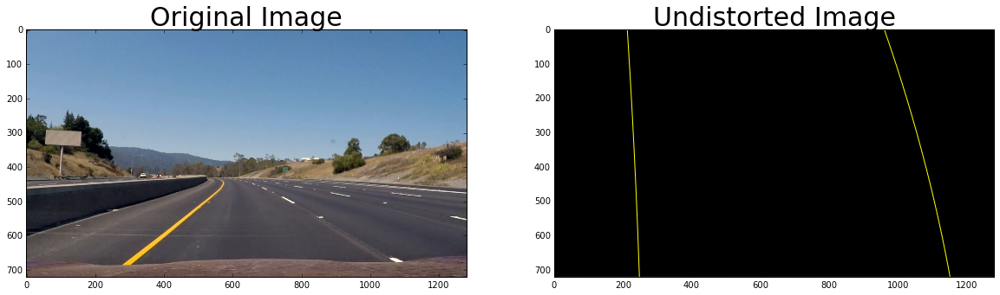

  7%|▋         | 83/1261 [03:30<49:50,  2.54s/it]

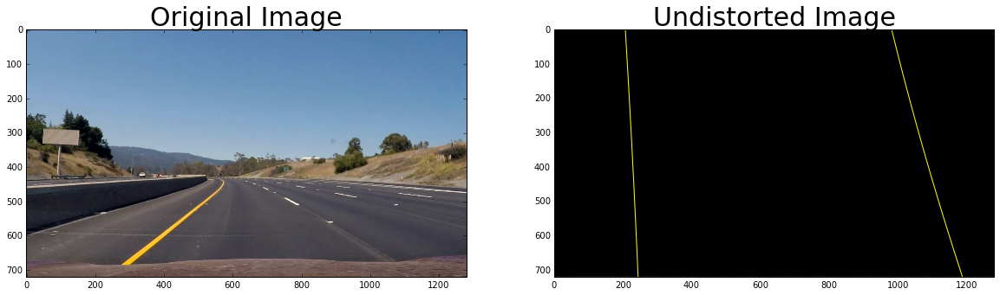

  7%|▋         | 84/1261 [03:33<52:34,  2.68s/it]

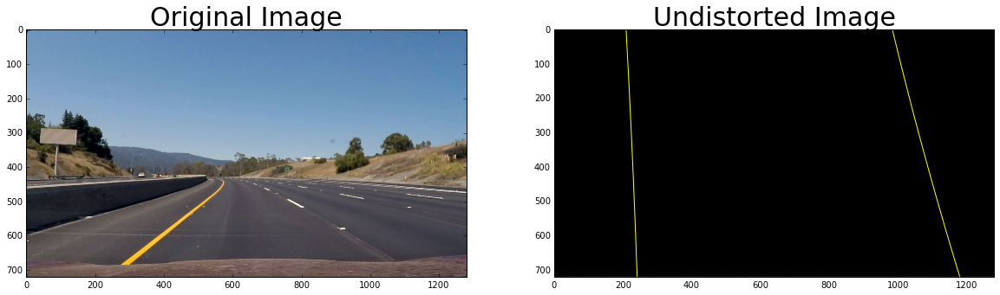

  7%|▋         | 85/1261 [03:35<51:58,  2.65s/it]

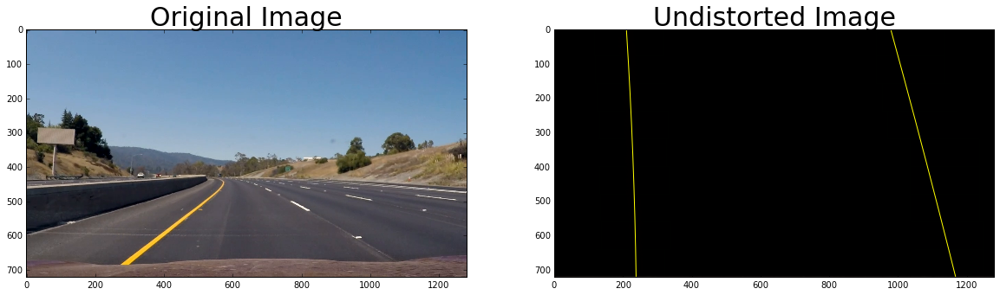

  7%|▋         | 86/1261 [03:38<51:03,  2.61s/it]

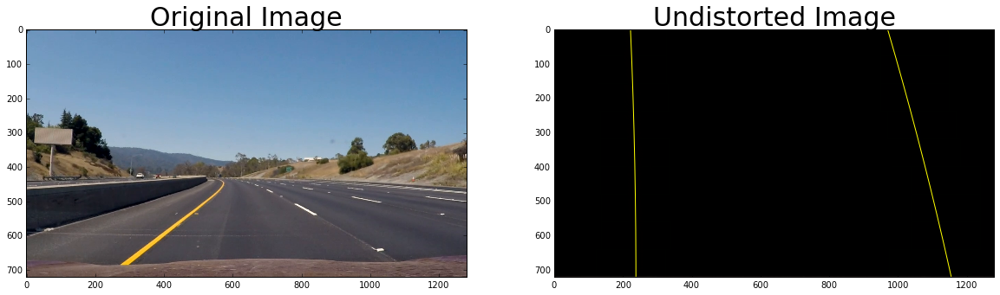

  7%|▋         | 87/1261 [03:41<52:03,  2.66s/it]

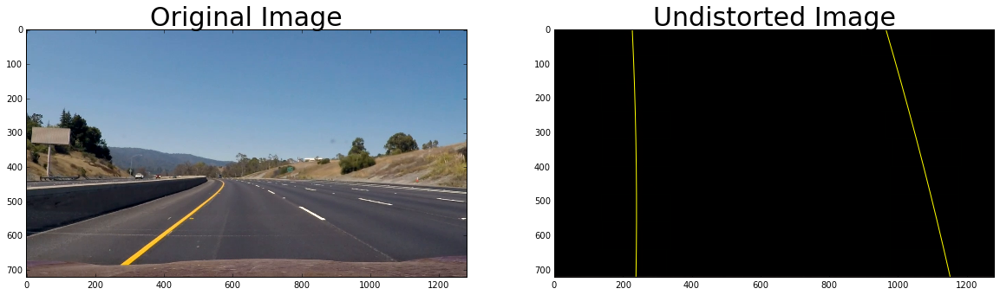

  7%|▋         | 88/1261 [03:43<51:51,  2.65s/it]

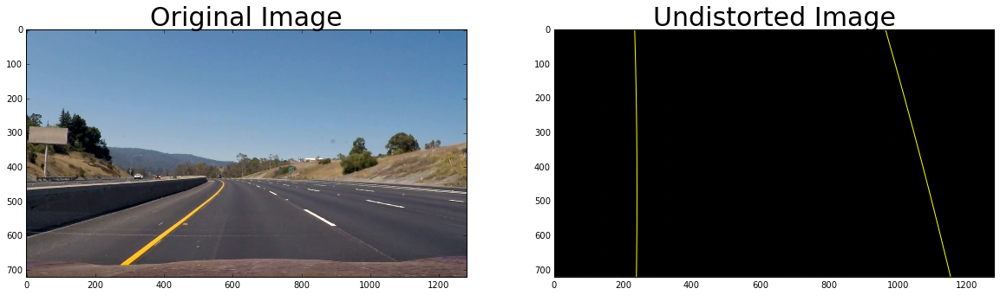

  7%|▋         | 89/1261 [03:46<52:00,  2.66s/it]

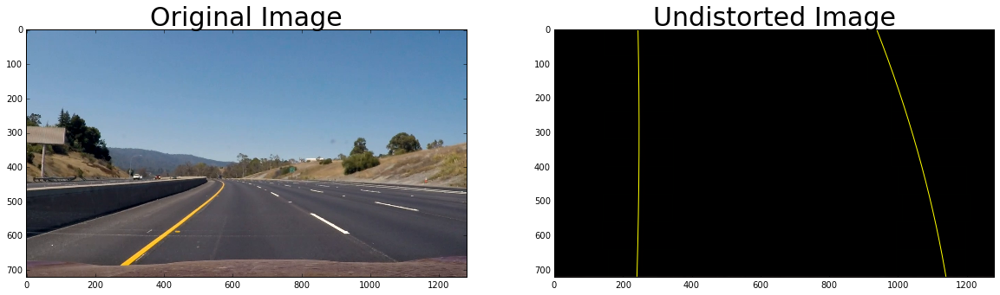

  7%|▋         | 90/1261 [03:49<51:58,  2.66s/it]

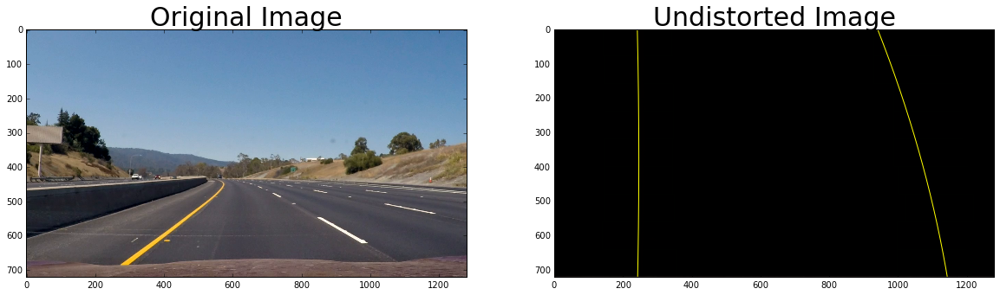

  7%|▋         | 91/1261 [03:51<51:32,  2.64s/it]

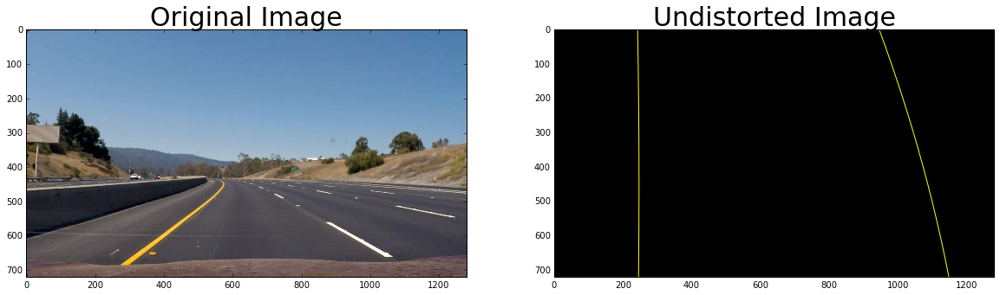

  7%|▋         | 92/1261 [03:54<50:47,  2.61s/it]

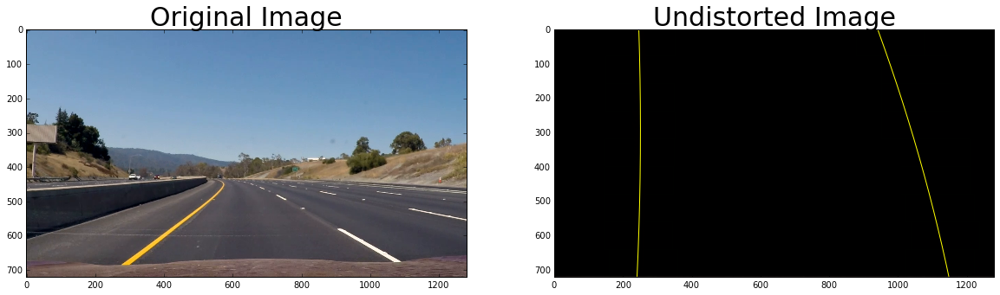

  7%|▋         | 93/1261 [03:56<50:49,  2.61s/it]

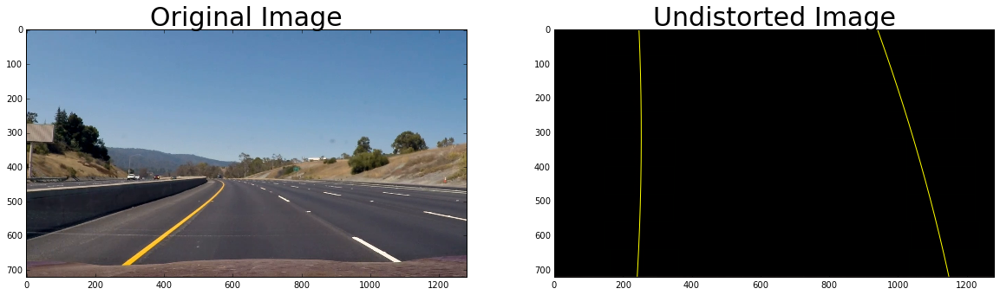

  7%|▋         | 94/1261 [03:59<50:08,  2.58s/it]

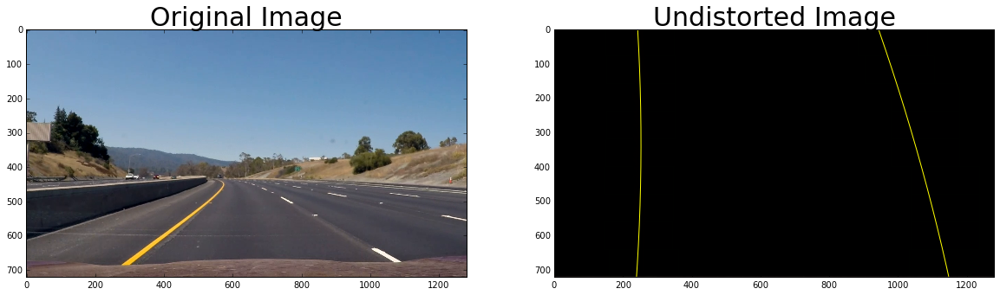

  8%|▊         | 95/1261 [04:01<50:44,  2.61s/it]

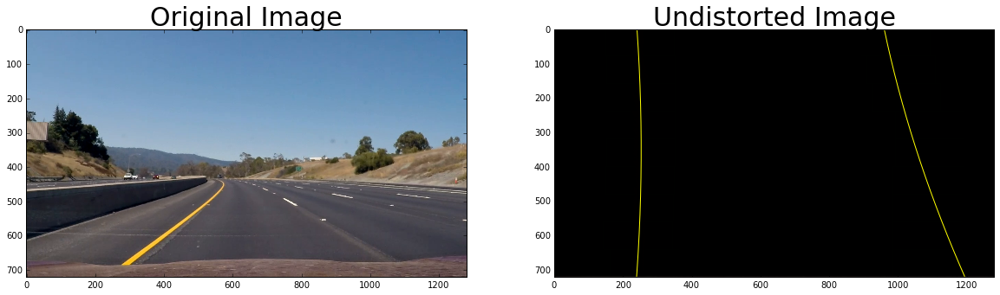

  8%|▊         | 96/1261 [04:04<50:04,  2.58s/it]

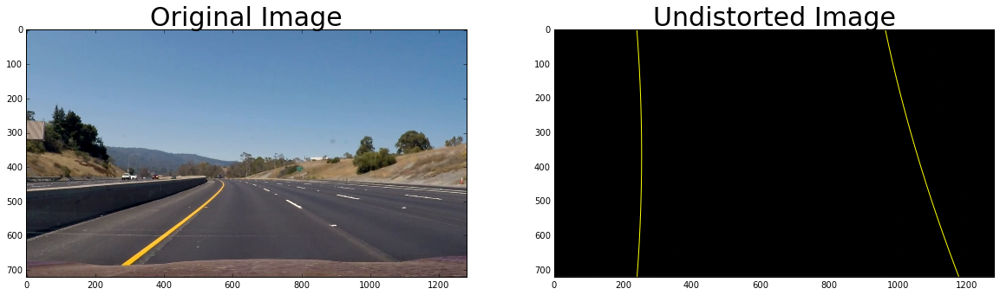

  8%|▊         | 97/1261 [04:06<49:27,  2.55s/it]

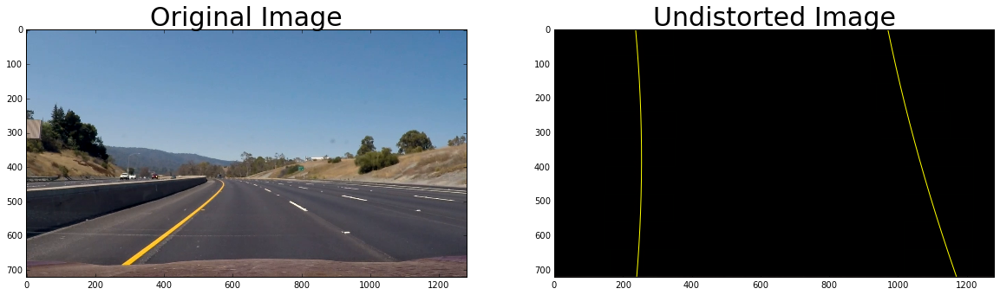

  8%|▊         | 98/1261 [04:09<49:10,  2.54s/it]

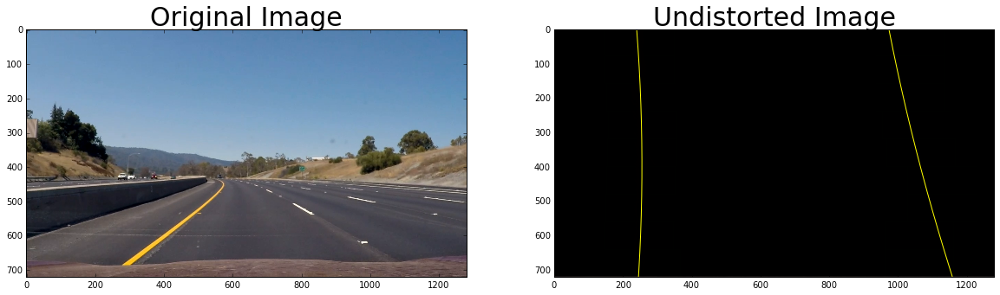

  8%|▊         | 99/1261 [04:11<48:18,  2.49s/it]

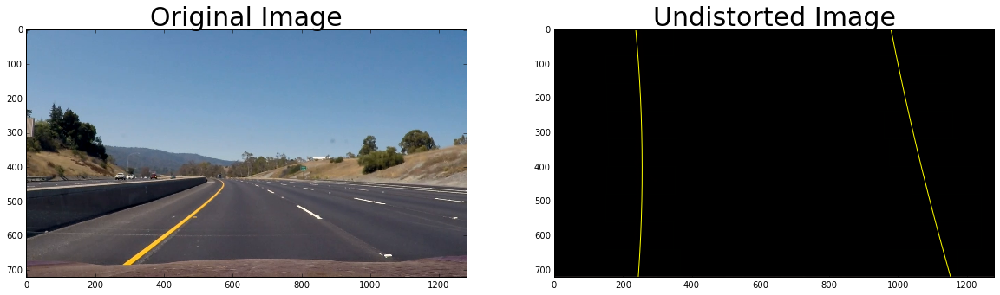

  8%|▊         | 100/1261 [04:14<48:27,  2.50s/it]

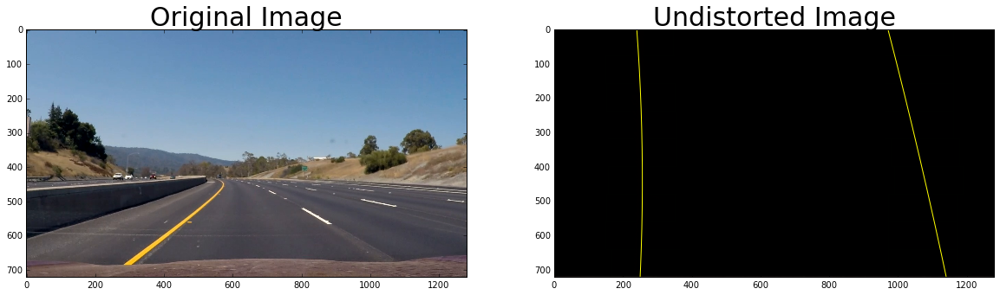

  8%|▊         | 101/1261 [04:16<48:29,  2.51s/it]

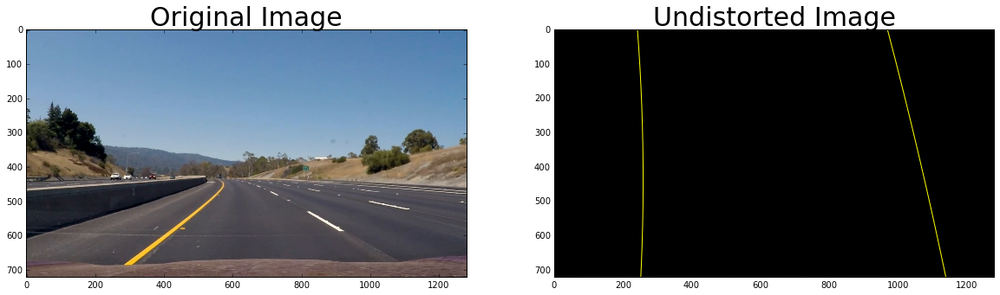

  8%|▊         | 102/1261 [04:19<47:56,  2.48s/it]

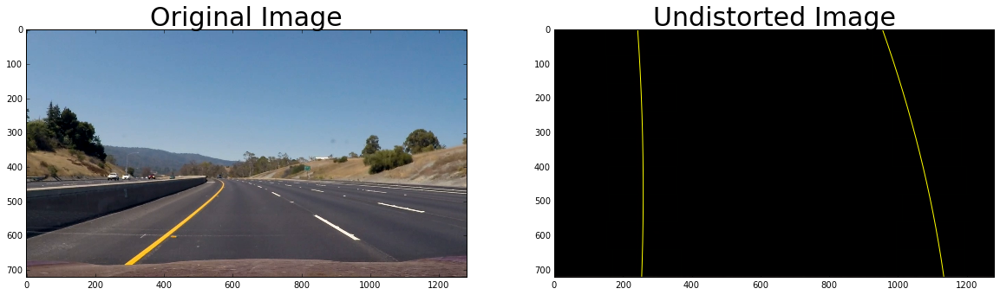

  8%|▊         | 103/1261 [04:21<47:39,  2.47s/it]

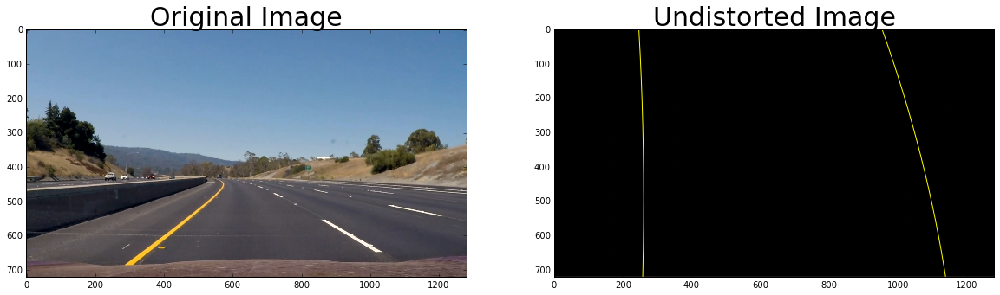

  8%|▊         | 104/1261 [04:24<47:34,  2.47s/it]

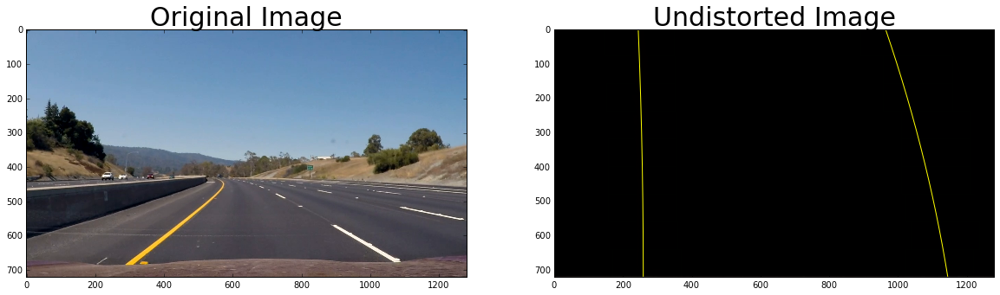

  8%|▊         | 105/1261 [04:26<47:26,  2.46s/it]

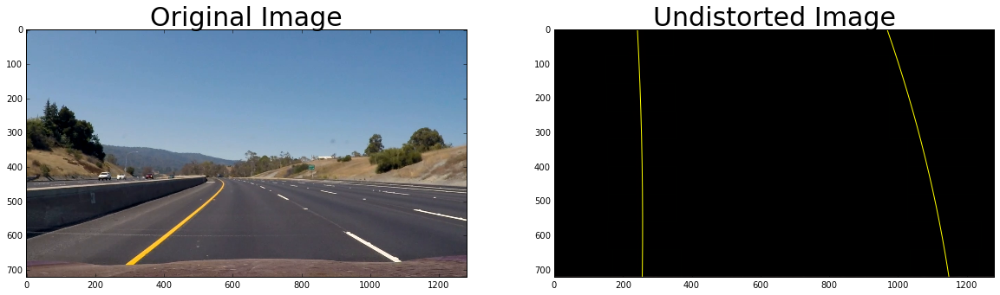

  8%|▊         | 106/1261 [04:29<48:43,  2.53s/it]

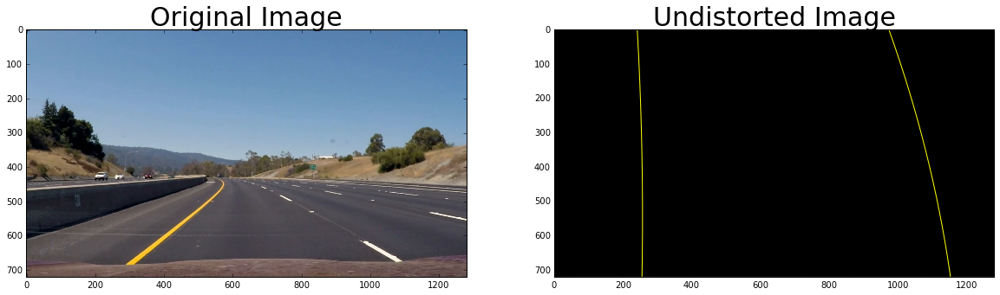

  8%|▊         | 107/1261 [04:31<48:23,  2.52s/it]

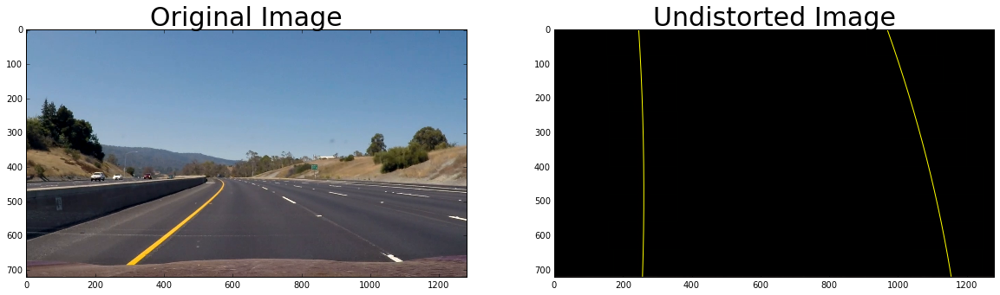

  9%|▊         | 108/1261 [04:34<48:03,  2.50s/it]

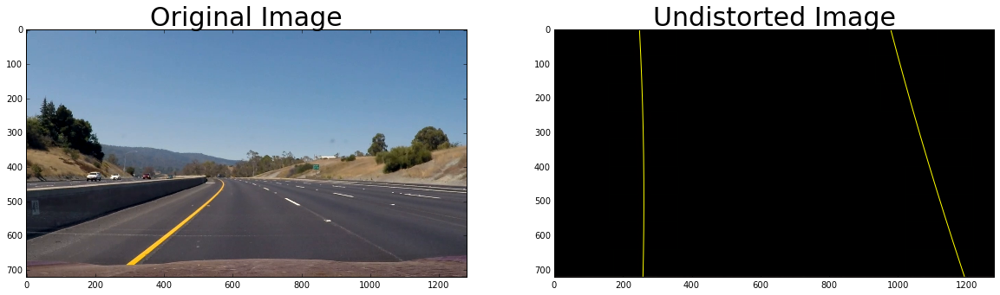

  9%|▊         | 109/1261 [04:36<48:28,  2.53s/it]

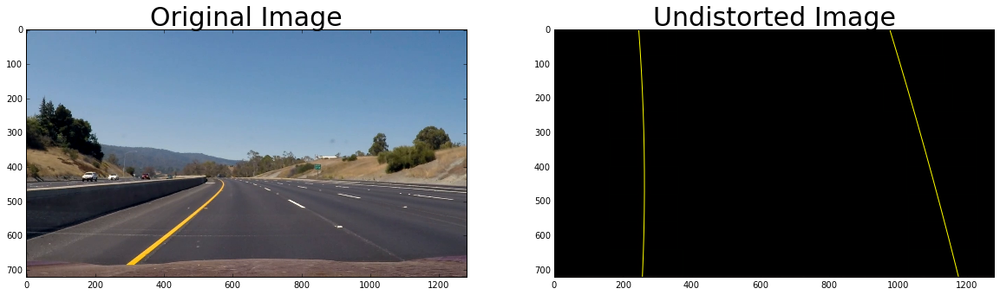

  9%|▊         | 110/1261 [04:39<48:45,  2.54s/it]

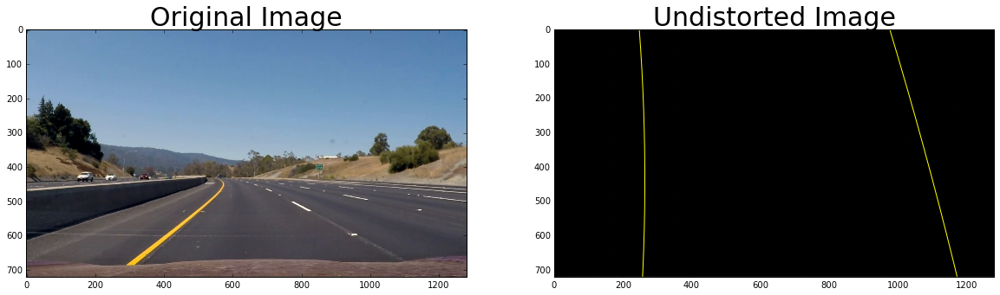

  9%|▉         | 111/1261 [04:42<48:54,  2.55s/it]

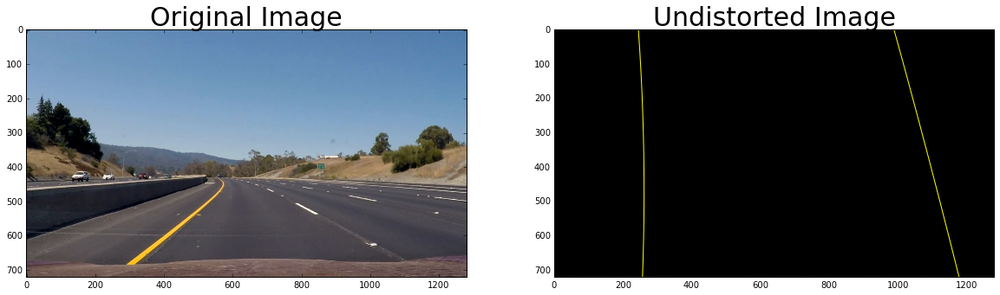

  9%|▉         | 112/1261 [04:44<48:10,  2.52s/it]

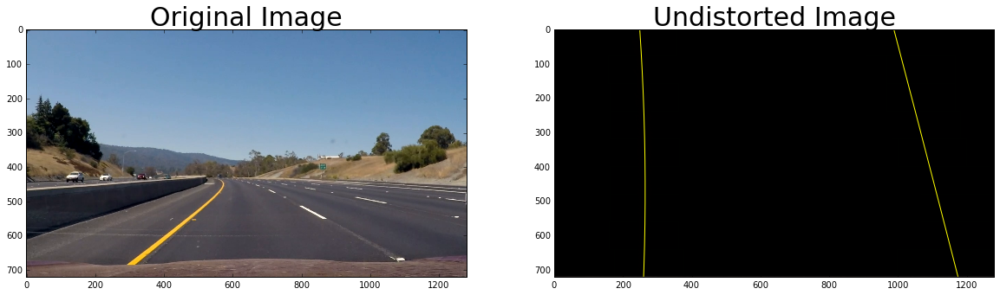

  9%|▉         | 113/1261 [04:46<47:47,  2.50s/it]

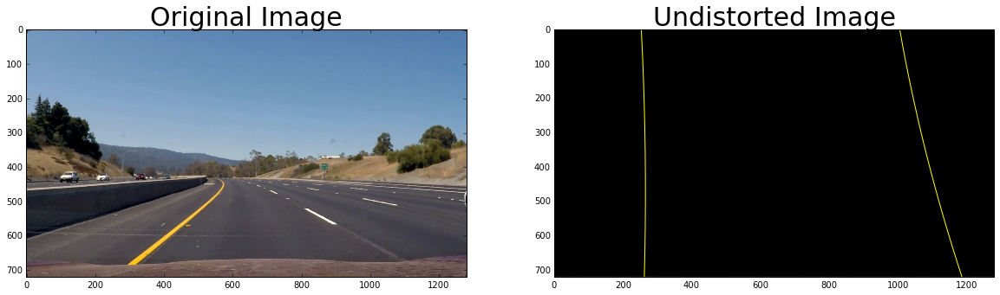

  9%|▉         | 114/1261 [04:49<47:30,  2.48s/it]

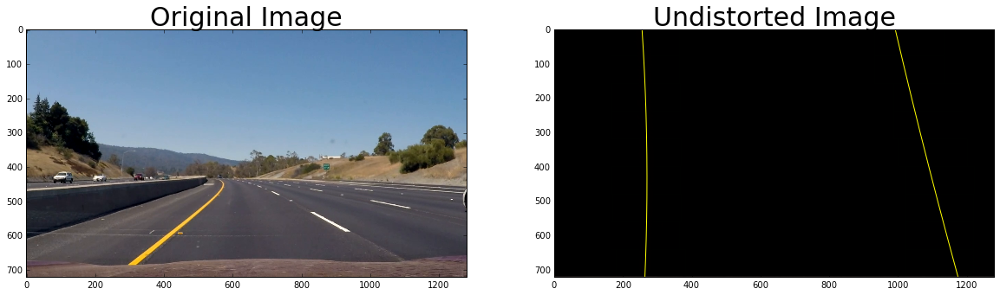

  9%|▉         | 115/1261 [04:51<47:35,  2.49s/it]

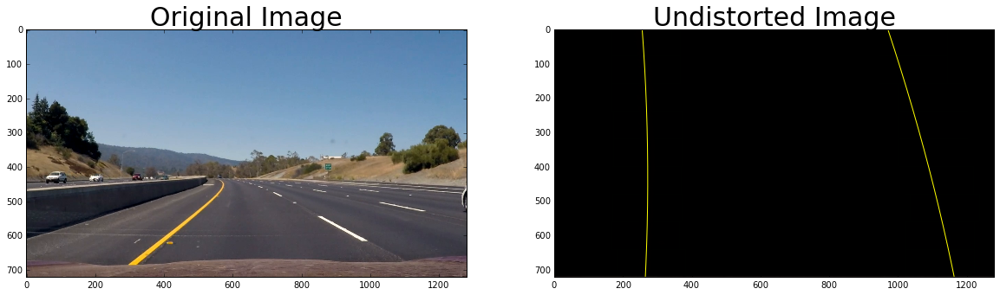

  9%|▉         | 116/1261 [04:54<47:25,  2.49s/it]

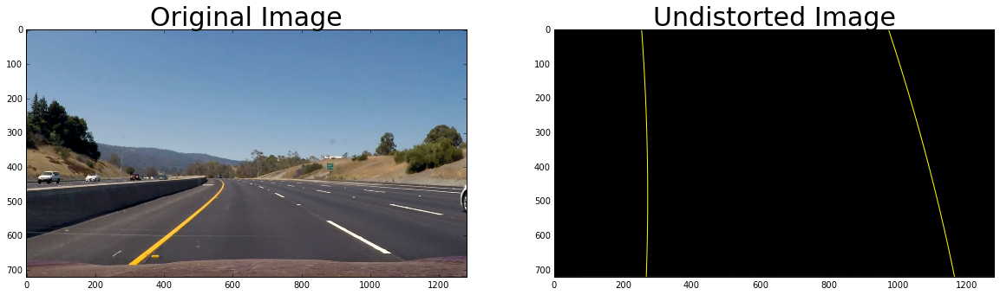

  9%|▉         | 117/1261 [04:56<47:53,  2.51s/it]

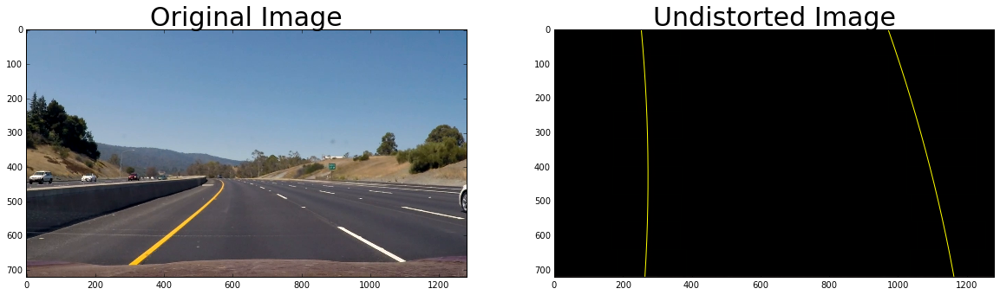

  9%|▉         | 118/1261 [04:59<47:58,  2.52s/it]

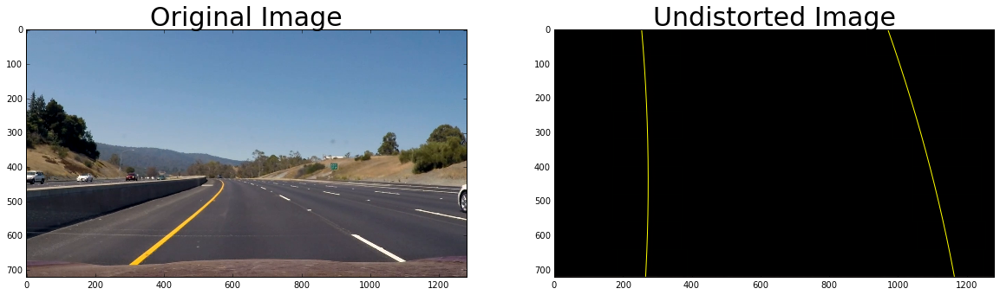

  9%|▉         | 119/1261 [05:01<47:11,  2.48s/it]

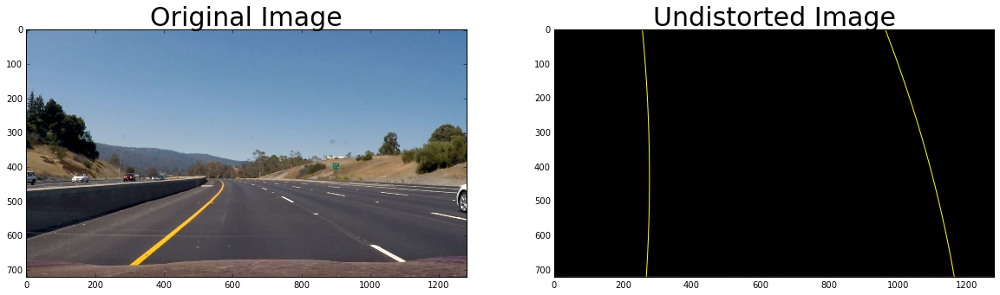

 10%|▉         | 120/1261 [05:04<46:54,  2.47s/it]

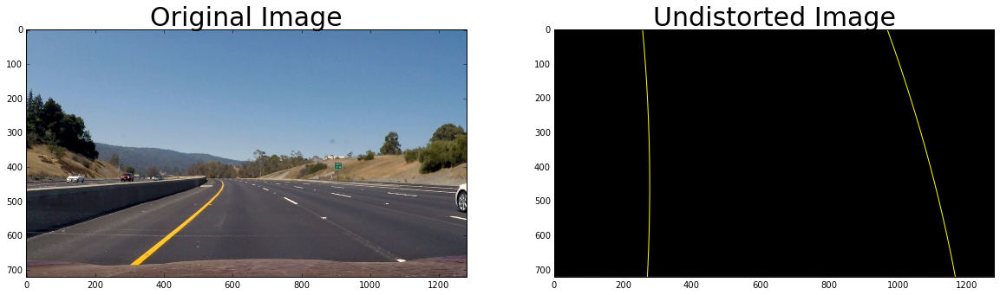

 10%|▉         | 121/1261 [05:06<46:54,  2.47s/it]

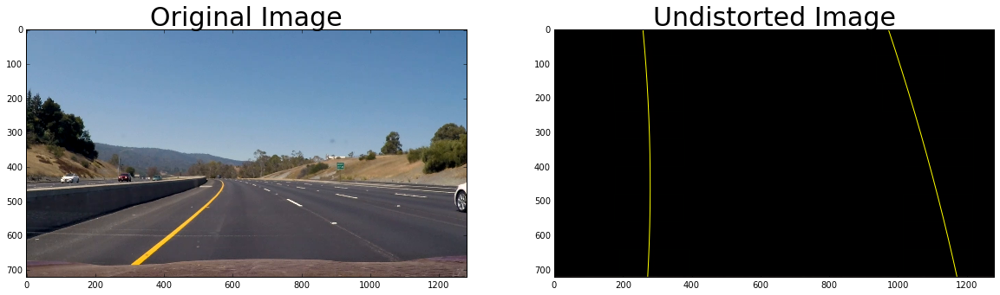

 10%|▉         | 122/1261 [05:09<47:26,  2.50s/it]

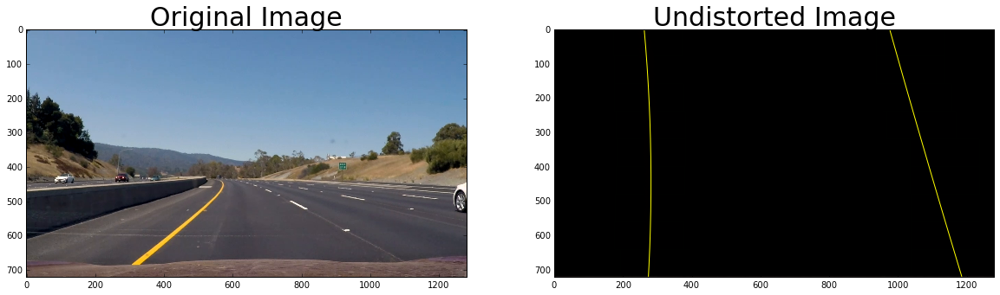

 10%|▉         | 123/1261 [05:11<47:13,  2.49s/it]

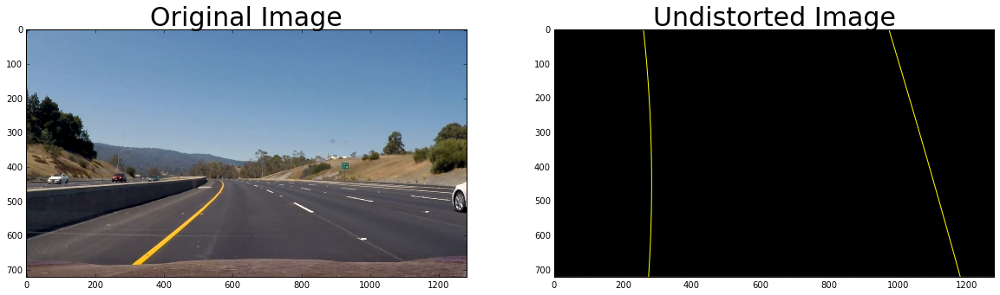

 10%|▉         | 124/1261 [05:14<47:11,  2.49s/it]

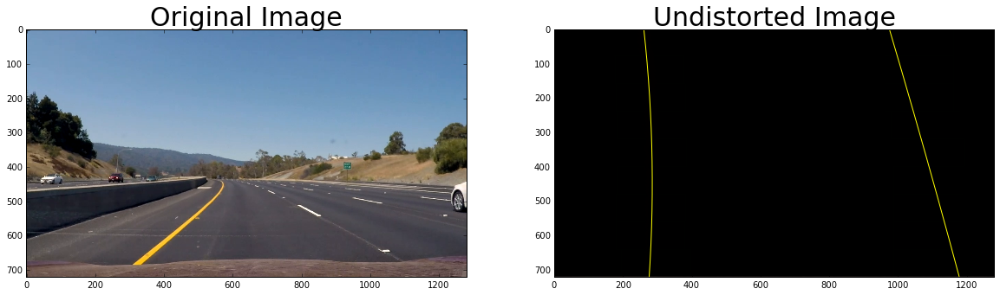

 10%|▉         | 125/1261 [05:16<47:04,  2.49s/it]

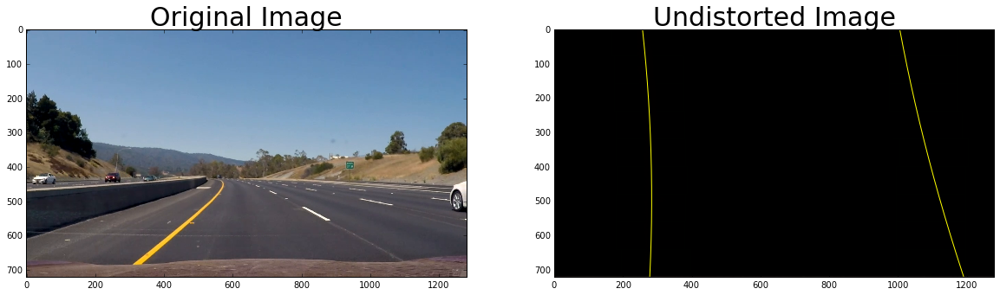

 10%|▉         | 126/1261 [05:19<47:42,  2.52s/it]

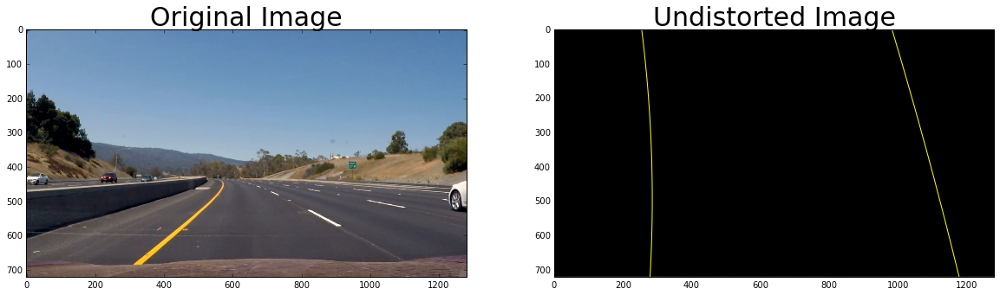

 10%|█         | 127/1261 [05:21<47:17,  2.50s/it]

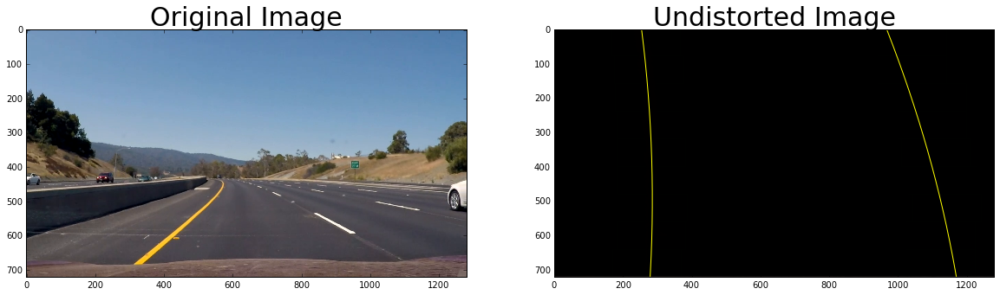

 10%|█         | 128/1261 [05:24<47:23,  2.51s/it]

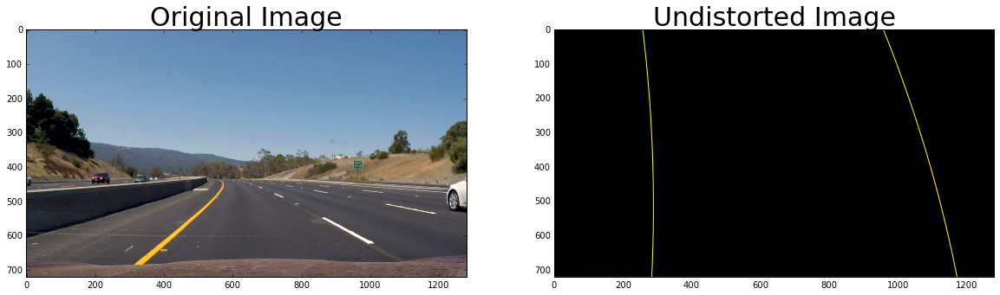

 10%|█         | 129/1261 [05:26<47:35,  2.52s/it]

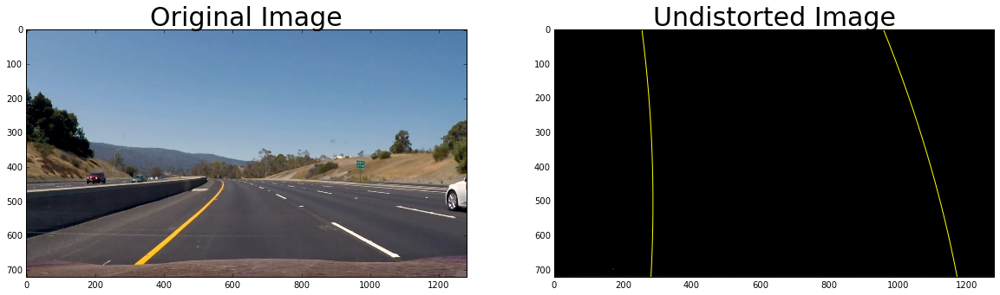

 10%|█         | 130/1261 [05:29<47:27,  2.52s/it]

In [ ]:
project_video_processed = 'project_video_processed.mp4'
video = VideoFileClip("project_video.mp4")
processed_clip = video.fl_image(advanced_lane_detection_pipeline) #NOTE: this function expects color images!!
%time processed_clip.write_videofile(project_video_processed, audio=False)

In [ ]:
project_video_processed = 'project_video_processed.mp4'

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video_processed))